# IMPORTS

In [1]:
%reload_ext autoreload
%autoreload 2
# GENERAL
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd

# LOADING DATA
import requests
import os
import shutil
from io import BytesIO
import osmium
import fiona
import json


# GEOSPATIAL DATA
from shapely.geometry import Point, LineString, MultiPoint
from shapely.geometry import shape 


# PLOTTING DATA
from folium import Map, CircleMarker, Vega, Popup, Marker, PolyLine, Icon, Choropleth, LayerControl
from folium.plugins import MarkerCluster, HeatMap, BeautifyIcon
from folium.features import ColorLine, GeoJsonPopup, GeoJsonTooltip
from folium.map import FeatureGroup
import shapely
import matplotlib
from ipywidgets import interact
import seaborn as sns

# STATS
import math
import stats

# ML
import scipy
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer, make_column_selector
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler



# Preprocessing 

## database n.1 : ROAD RISK ~ Shape file

The first database we are cleaning is a shape file containing segments of road in Porto and Lisbon. 
In the next steps we are preparing the dataset for the future analysis.

### Extracting Data

In [2]:
# link = 'https://wdl-data.fra1.digitaloceanspaces.com/pse/m_risk_prfile.zip'
# s = requests.get(link).content

In [3]:
def first_df(path):
    geo = gpd.read_file(path)
    df = pd.DataFrame(geo).drop(columns='Link_ID')
    df_ren = df.rename(columns={
                        'Daily_Aver':'Daily_Average_Traffic_Intensity',
                        'Average_Ve':'Average_Velocity_of_Vehicle_Traffic',
                        'Median_of_':'Median_of_velocity_of_Vehicle_Traffic',
                        'First_Quar': 'FirstQuartil_of_velocity_of_Vehicle_Traffic',
                        'Third_Quar': 'ThirdQuartil_of_velocity_of_Vehicle_Traffic'
                    })
    return df_ren
    
df = first_df('wdl_data/m_risk_prfile.geojson') 

- Now we have a dataset containing the same columns but renamed. 
- We also drop the 'Link_ID' column as contain the unique id of the streat, information already present in linkid column

To have a better understanding on our data and to avoid errors during our analysis we need to investigate it with general statistics

### Remove outliers: 

In [4]:
df.describe()

,linkid,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Func_Class,Speed_Cat
count,3.467800e+04,34678.000000,34678.000000,34678.000000,34678.000000,34678.000000,34678.000000,34678.000000
mean,8.958206e+08,3340.417942,56.816834,56.463409,43.822041,68.091844,2.684613,4.904781
std,2.355910e+08,2725.873982,51.983670,26.240876,24.442204,30.985191,0.538658,1.520568
min,8.021682e+07,14.435864,-401.703724,1.000000,-392.500000,1.000000,1.000000,2.000000
25%,7.364832e+08,1903.398108,38.315321,38.250000,26.000000,48.000000,2.000000,4.000000
50%,9.067377e+08,2644.529317,49.966126,50.000000,38.875000,60.333333,3.000000,6.000000
75%,1.154997e+09,3897.886608,69.511585,71.000000,56.000000,85.000000,3.000000,6.000000
max,1.223731e+09,49309.806935,6357.022296,1326.250000,143.000000,2605.000000,3.000000,7.000000


- Regarding the columns we know that they report values in km/h: many of the min and max we can observe thank to describe function don't make sense. 
- We need to operate on them as they are **outliers**

In [5]:
def rm_out(df):
    for i in df.columns.drop(['linkid', 'Daily_Average_Traffic_Intensity','geometry']):
        lb = 0
        ub = 180
#         print(lb, ub)
        df[i] = df[i].mask(df[i] < lb) 
        df[i] = df[i].mask(df[i] > ub) 
    return df

data = rm_out(df)

**If we run describe again we will see that the data regarding velocity has just feasible values.**

In [6]:
data.describe()

,linkid,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Func_Class,Speed_Cat
count,3.467800e+04,34678.000000,34633.000000,34675.000000,34677.000000,34674.000000,34678.000000,34678.000000
mean,8.958206e+08,3340.417942,56.112805,56.402803,43.834624,67.959767,2.684613,4.904781
std,2.355910e+08,2725.873982,24.346245,25.054113,24.329987,26.706718,0.538658,1.520568
min,8.021682e+07,14.435864,1.000000,1.000000,0.000000,1.000000,1.000000,2.000000
25%,7.364832e+08,1903.398108,38.317003,38.250000,26.000000,48.000000,2.000000,4.000000
50%,9.067377e+08,2644.529317,49.961538,50.000000,38.875000,60.333333,3.000000,6.000000
75%,1.154997e+09,3897.886608,69.447459,71.000000,56.000000,85.000000,3.000000,6.000000
max,1.223731e+09,49309.806935,179.691892,143.250000,143.000000,164.000000,3.000000,7.000000


### Handling duplicates:

In [7]:
len(data) == len(data.drop_duplicates())

True

There are ***no duplicates*** in our dataset

### Handling missing values:

In [8]:
data.isnull().sum().sort_values(ascending=False) , f'Total of data points : {data.shape[0]}'

(Average_Velocity_of_Vehicle_Traffic            45
 ThirdQuartil_of_velocity_of_Vehicle_Traffic     4
 Median_of_velocity_of_Vehicle_Traffic           3
 FirstQuartil_of_velocity_of_Vehicle_Traffic     1
 linkid                                          0
 Daily_Average_Traffic_Intensity                 0
 Func_Class                                      0
 Speed_Cat                                       0
 geometry                                        0
 dtype: int64,
 'Total of data points : 34678')

As we can see the total highest number of missing values detected for column is 45 on a total number of rows of 34'678.
- The missing value for Average Velocity e the ones in Speed Difference Mean are the same (one column is created from the other one)
- The missing values of other column can be easily deleted

**As we are handling data regarding AVERAGE velocity we can easily substitute the missing values with the mean of the corresponding column**

In [9]:
def handling_missing(data):
    imputer = SimpleImputer()
    data['Average_Velocity_of_Vehicle_Traffic']=imputer.fit_transform(data[['Average_Velocity_of_Vehicle_Traffic']])
    return data.dropna()
data = handling_missing(data)

In [10]:
data.isnull().sum()

linkid                                         0
Daily_Average_Traffic_Intensity                0
Average_Velocity_of_Vehicle_Traffic            0
Median_of_velocity_of_Vehicle_Traffic          0
FirstQuartil_of_velocity_of_Vehicle_Traffic    0
ThirdQuartil_of_velocity_of_Vehicle_Traffic    0
Func_Class                                     0
Speed_Cat                                      0
geometry                                       0
dtype: int64

### Feature creation:

Now looking at our data we need to search for a target that in the next step we will use in our model.
Most common causes of Accidents:
- Over Speeding.
- Drunken Driving.
- Distractions to Driver.
- Red Light Jumping.
- Avoiding Safety Gears like Seat belts and Helmets.
- Non-adherence to lane driving and overtaking in a wrong manner.

The first cause is always the **over-speed** that can be connected with one of the above causes. 
For this reason we decide to investigate and use as target information regarding the velocity.

- Speed_Cat (described in the excel above)
- Average Velocity of Vehicle Traffic 
- Median of velocity of Vehicle Traffic

We will create a dictionary that, from the information contained in the excel can describe the type of street regarding the max velocity allowed in there. 


In [11]:
speed_explanation = pd.read_excel('wdl_dict/Dictionary_Risk_Profiles.xlsx', sheet_name='SpeedCat')
speed_explanation

,Speed Cat,Speed range in km/h
0,1,>130 km/h
1,2,101-130 km/h
2,3,91-100 km/h
3,4,71-90 km/h
4,5,51-70 km/h
5,6,31-50 km/h
6,7,11-30 km/h
7,8,<11 km/h


 from the table above we can create a dictionary.
1. count values for category
2. translate the speed range in actual number

In [12]:
data.Speed_Cat.value_counts()

6    20307
4     5273
2     5123
3     1843
5     1770
7      357
Name: Speed_Cat, dtype: int64

**NO need of mapping for label 1 and 8**

In [13]:
max_speed_dict = {2:130,3:100,4:90,5:70,6:50,7:30}

In [14]:
def target_creation(data):
    data['Max_speed'] = data['Speed_Cat'].map(max_speed_dict)
    data['Speed_Diff_Mean'] = data['Max_speed'] - data['Average_Velocity_of_Vehicle_Traffic']
    data['Speed_Diff_Median'] = data['Max_speed'] - data['Median_of_velocity_of_Vehicle_Traffic']
    return data
data = target_creation(data)

<ipython-input-14-63521103fb59>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Max_speed'] = data['Speed_Cat'].map(max_speed_dict)
<ipython-input-14-63521103fb59>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Speed_Diff_Mean'] = data['Max_speed'] - data['Average_Velocity_of_Vehicle_Traffic']
<ipython-input-14-63521103fb59>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in

In [15]:
data[['Speed_Cat','Max_speed', 'Speed_Diff_Mean','Speed_Diff_Median']].head(10)

,Speed_Cat,Max_speed,Speed_Diff_Mean,Speed_Diff_Median
0,6,50,4.791284,5.535714
1,4,90,10.436692,7.250000
2,6,50,-15.955069,-17.333333
3,6,50,2.466089,6.000000
4,6,50,-1.375291,-3.250000
5,6,50,17.667821,18.333333
6,6,50,19.613591,22.937500
7,6,50,26.714286,39.000000
8,6,50,6.476409,4.000000
9,6,50,-11.897045,1.346154


________________

#################### ADD THIS IN ORIGINAL NOTEBOOK #######################

In [193]:
data.Average_Velocity_of_Vehicle_Traffic.value_counts(bins=30).max()

4535

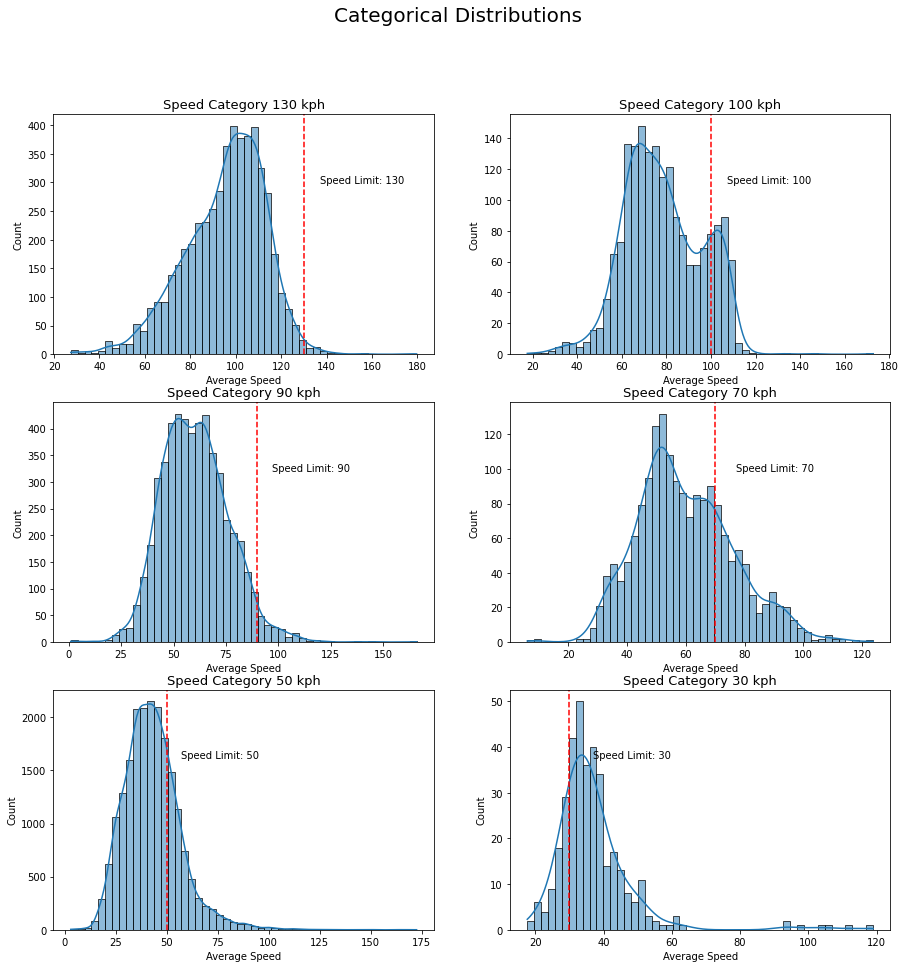

In [292]:
cat_list = {x:data[data['Max_speed']==x] for x in max_speed_dict.values()}
def speed_dist(cat_list):
    fig, axs = plt.subplots(3, 2, figsize=(15, 15))
    fig.suptitle('Categorical Distributions', size=20)
#     fig.tight_layout()
    for c, i in enumerate(cat_list.items()):
        speedlim = i[0]
        plt.subplot(3, 2, c+1)
#         plt.set_xlabel('Average Speed')
#         ax = i[1].Average_Velocity_of_Vehicle_Traffic.hist(bins=30)
        ax = sns.histplot(i[1].Average_Velocity_of_Vehicle_Traffic, kde=True, bins=50)
        ylim = i[1].Average_Velocity_of_Vehicle_Traffic.value_counts(bins=50).max()
        ax.set_title(f'Speed Category {i[0]} kph', size=13)
        ax.set_xlabel('Average Speed')
        ax.axvline(speedlim, color='r', linestyle='--')
#         print(f'done {speedlim}, {ylim/2}, {speedlim}')
        ax.text(x=speedlim+7, y=float(ylim-ylim/4), s=f'Speed Limit: {speedlim}')
        
speed_dist(cat_list)

**Note**<br>
We can see that most over speeding is taking place at roads with lower speed limits such as **50 kph and 30 kph.**

_______________

**our first target will be the difference between the mean of velocity and the max speed**

### Scaling features:

We are now ready to scale our dataframe to have a distribution *around* the mean.

1. We need to separate numerical and categorical column
2. We are going to use the Min-Max Scaling method for the numerical ones: is the one that is commonly used distance based algorithms, as k-means that is one of the possible analysis we are taking in consideration.  
3. For the categorical ones we'll use the OneHotEncoding method (for each label in each category creates a different column)

We could also operate this step all together but is important for us to know which column belong to each of the different classes inside the categorical feature. 
**To do so we need to operate for each categorical separately**

In [16]:
def scaling_numerical(data):
    numerical = data.columns.drop(['geometry','linkid','Speed_Cat', 'Func_Class'])
    scaler = StandardScaler()
    data_scaled = data.copy()
    for column in numerical:
        scaler.fit(data_scaled[[column]])
        data_scaled[column]=scaler.transform(data_scaled[[column]]) 
    return data_scaled
data_scaled = scaling_numerical(data)

In [17]:
data.drop(columns=['geometry','linkid','Speed_Cat', 'Func_Class']).head(1)

,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Max_speed,Speed_Diff_Mean,Speed_Diff_Median
0,6224.778569,45.208716,44.464286,28.0,59.0,50,4.791284,5.535714


In [18]:
data_scaled.drop(columns=['geometry','linkid','Speed_Cat', 'Func_Class']).head(1)

,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Max_speed,Speed_Diff_Mean,Speed_Diff_Median
0,1.058039,-0.448154,-0.476554,-0.650809,-0.33552,-0.716756,-0.549408,-0.506457


**Working with the categorical features the first thing we need to do is to understand the distribution within the labels**

In [19]:
data.Func_Class.value_counts() , data.Speed_Cat.value_counts()

(3    25023
 2     8363
 1     1287
 Name: Func_Class, dtype: int64,
 6    20307
 4     5273
 2     5123
 3     1843
 5     1770
 7      357
 Name: Speed_Cat, dtype: int64)

- Functional Class has just 3 possible label for the street that we can understand better looking at the excel

In [20]:
func_explanation = pd.read_excel('wdl_dict/Dictionary_Risk_Profiles.xlsx', sheet_name='Func_Class')
for i,el in enumerate(func_explanation['Description']):
    print(f'Class n.{i+1} : {el} \n')

Class n.1 : These roads are meant for high volume, maximum speed traffic between and through major metropolitan areas. There are very few, if any, speed changes. Access to this road is usually controlled. 

Class n.2 : These roads are used to channel traffic to Main Roads (FRC1) for travel between and through cities in the shortest amount of time. There are very few, if any speed changes. 

Class n.3 : These roads interconnect First Class Roads (FRC2) and provide a high volume of traffic movement at a lower level of mobility than First Class Roads (FRC2). 



With this new and deeper understanding of the distribution and the meaning of the category (*NB: regarding speed_cat we can look back at the point **1.1.5 "Feature creation"** to get these informations)* we can now progress with our transformations.  

In [21]:
def scaling_categorical(data):
    ohe = OneHotEncoder(sparse = False)
    ohe.fit(data[['Func_Class']])
    func_encoded = ohe.transform(data[['Func_Class']])
    data["func_1"],data["func_2"],data['func_3'] = func_encoded.T
    ohe = OneHotEncoder(sparse = False)
    ohe.fit(data[['Speed_Cat']])
    speed_encoded = ohe.transform(data[['Speed_Cat']])
    data["speed_2"],data["speed_3"],data["speed_4"],\
    data["speed_5"], data["speed_6"], data["speed_7"]= speed_encoded.T
    return data 

In [22]:
data_scaled = scaling_categorical(data_scaled)

### Preprocessed Dataframe: 

In [23]:
data_scaled.columns

Index(['linkid', 'Daily_Average_Traffic_Intensity',
       'Average_Velocity_of_Vehicle_Traffic',
       'Median_of_velocity_of_Vehicle_Traffic',
       'FirstQuartil_of_velocity_of_Vehicle_Traffic',
       'ThirdQuartil_of_velocity_of_Vehicle_Traffic', 'Func_Class',
       'Speed_Cat', 'geometry', 'Max_speed', 'Speed_Diff_Mean',
       'Speed_Diff_Median', 'func_1', 'func_2', 'func_3', 'speed_2', 'speed_3',
       'speed_4', 'speed_5', 'speed_6', 'speed_7'],
      dtype='object')

## Feature engineering

We assume that ***over speeding*** is the main reason for road hazards. Over speeding behavior can be extracted by the deltas between the road's speed category and its actual average speed observations as processed in column ```Speed_Diff_Mean```. <br>

Over speeding can be harnessed among others by the roads environment [Source](https://www.tandfonline.com/doi/abs/10.1080/014416499295420). People chose their speeding behavior not only by speed limits but also by their assessment of the road's quality and the surrounding environment.<br>

Therefore we chose to gather more information about POIs, amenities and public buildings in the surrounding of the provided road segments. Those can be acquired through OSM sources.

### Scaling data set to Lisbon

#########################################################<br>
***_----------FILL WITH EXPLANATION SISTO------------_***<br>
#########################################################

In [24]:
# Transforming pandas df to geopandas df
geo_df = gpd.GeoDataFrame(data_scaled)
geo_df.geometry[0].type

'MultiLineString'

In [25]:
## Filtering only lisbon data inside the circle of 38.72526068747401, -9.142352617846093 with buffer '1'
circle_lisbon = Point(-9.142352617846093, 38.72526068747401).buffer(1)
geo_lis = geo_df[geo_df.geometry.within(circle_lisbon)]
# no immediate usage of this pd.DataFrame
df_lis = pd.DataFrame(geo_lis).drop(columns=['geometry', 'linkid'])

In [26]:
print(f'The new data set has {df_lis.shape[0]} rows as opposed to the original set with {geo_df.shape[0]} rows')

The new data set has 17688 rows as opposed to the original set with 34673 rows


### Loading OSM Maps

In [27]:
%%bash
wget https://download.bbbike.org/osm/extract/planet_-9.89,38.265_-8.309,39.136.osm.pbf \
    --quiet -O map_data/Lisbon.osm.pbf

In [28]:
!ogrinfo map_data/Lisbon.osm.pbf

INFO: Open of `map_data/Lisbon.osm.pbf'
      using driver `OSM' successful.
1: points (Point)
2: lines (Line String)
3: multilinestrings (Multi Line String)
4: multipolygons (Multi Polygon)
5: other_relations (Geometry Collection)


In [213]:
# due to a large data set the file has to be loaded as pd.DataFrame before it can be transformed into a gpd.GeoDataFrame
poi_df = pd.read_csv('map_data/gdf_lis_poly.csv')
poi_df['geometry'] = poi_df['geometry'].apply(shapely.wkt.loads)
poi_gdf = gpd.GeoDataFrame(poi_df, crs='OGC:CRS84')

/Users/moritzgeiger/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (3,5,6,7,9,10) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [212]:
# about 20 sec
%%bash
ogr2ogr -f "GPKG" \
    map_data/lisbon_polygons.gpkg \
    map_data/Lisbon.osm.pbf \
    -nlt POLYGONS \
    -nln polygons

SyntaxError: invalid syntax (<ipython-input-212-27c3db53f286>, line 3)

In [ ]:
#Read data
# about 3 mins
layer_file = "map_data/lisbon_polygons.gpkg"
collection = list(fiona.open(layer_file,'r'))
df1 = pd.DataFrame(collection)

#Check Geometry
def isvalid(geom):
    try:
        shape(geom)
        return 1
    except:
        return 0

df1['isvalid'] = df1['geometry'].apply(lambda x: isvalid(x))
df1 = df1[df1['isvalid'] == 1]
collection = json.loads(df1.to_json(orient='records'))

#Convert to geodataframe
gdf_lis_poly = gpd.GeoDataFrame.from_features(collection)

In [ ]:
gdf_lis_poly

In [ ]:
poi_gdf = gdf_lis_poly.copy()

In [ ]:
# poi_gdf

### Loading POIs from pre-processed OSM file

In [214]:
print(f'The data set of POIs in the Lisbon region has {poi_gdf.shape[0]} individual points which can be merged with our data set.' )

The data set of POIs in the Lisbon region has 719511 individual points which can be merged with our data set.


In [215]:
poi_gdf.geometry.type.value_counts()

Polygon               420865
LineString            195623
Point                  99120
GeometryCollection      3261
MultiLineString          642
dtype: int64

***Note***<br>
For now we will only be focussing on the geometrical points in the OSM data, not on polygons or line strings.

In [216]:
# filtering down to shapely.geometry.Points
gdf_points = poi_gdf[poi_gdf['geometry'].type == 'Point'].reset_index()
gdf_points.columns

Index(['index', 'geometry', 'osm_id', 'name', 'amenity', 'barrier', 'building',
       'highway', 'landuse', 'man_made', 'natural', 'office'],
      dtype='object')

**Note**<br>
The points provided are categorized and stored in many columns. We will shrink this information to one column and fill it with all the important information about the point. <br>
Some points do not provide any information. Those ones will be dropped. 

In [217]:
# reducing geo_df columns, only leaving one valid column
def new_desc(geo):
    geo['desc_points'] = None
    # columns to be taken into consideration
    lst_cols = [  'amenity', 
                  'barrier', 
                  'building', 
                  'highway', 
                  'landuse', 
                  'man_made', 
                  'natural', 
                  'office']
    for c, row in geo.iterrows():
#         concat_name = [f'feat_{i}_{row[i]}' for i in lst_cols if row[i] == row[i]]
        concat_name = [f'feat_{i}_{row[i]}' for i in lst_cols if row[i] != None]
        if len(concat_name) > 0:
            geo.at[c, 'desc_points'] = concat_name[0]
        else: 
            geo.at[c, 'desc_points'] = None
        print(f'done: {c}')
        
    
    geo = geo[['geometry', 'desc_points']]
    # drop empty descriptions
    geo = geo.dropna(subset=['desc_points'])
    geo= geo.reset_index(drop=True)
    
    return geo

In [218]:
# applying cleaning function to geo df
gdf_points_clean = new_desc(gdf_points)

done: 0
done: 1
done: 2
done: 3
done: 4
done: 5
done: 6
done: 7
done: 8
done: 9
done: 10
done: 11
done: 12
done: 13
done: 14
done: 15
done: 16
done: 17
done: 18
done: 19
done: 20
done: 21
done: 22
done: 23
done: 24
done: 25
done: 26
done: 27
done: 28
done: 29
done: 30
done: 31
done: 32
done: 33
done: 34
done: 35
done: 36
done: 37
done: 38
done: 39
done: 40
done: 41
done: 42
done: 43
done: 44
done: 45
done: 46
done: 47
done: 48
done: 49
done: 50
done: 51
done: 52
done: 53
done: 54
done: 55
done: 56
done: 57
done: 58
done: 59
done: 60
done: 61
done: 62
done: 63
done: 64
done: 65
done: 66
done: 67
done: 68
done: 69
done: 70
done: 71
done: 72
done: 73
done: 74
done: 75
done: 76
done: 77
done: 78
done: 79
done: 80
done: 81
done: 82
done: 83
done: 84
done: 85
done: 86
done: 87
done: 88
done: 89
done: 90
done: 91
done: 92
done: 93
done: 94
done: 95
done: 96
done: 97
done: 98
done: 99
done: 100
done: 101
done: 102
done: 103
done: 104
done: 105
done: 106
done: 107
done: 108
done: 109
done: 110


done: 1264
done: 1265
done: 1266
done: 1267
done: 1268
done: 1269
done: 1270
done: 1271
done: 1272
done: 1273
done: 1274
done: 1275
done: 1276
done: 1277
done: 1278
done: 1279
done: 1280
done: 1281
done: 1282
done: 1283
done: 1284
done: 1285
done: 1286
done: 1287
done: 1288
done: 1289
done: 1290
done: 1291
done: 1292
done: 1293
done: 1294
done: 1295
done: 1296
done: 1297
done: 1298
done: 1299
done: 1300
done: 1301
done: 1302
done: 1303
done: 1304
done: 1305
done: 1306
done: 1307
done: 1308
done: 1309
done: 1310
done: 1311
done: 1312
done: 1313
done: 1314
done: 1315
done: 1316
done: 1317
done: 1318
done: 1319
done: 1320
done: 1321
done: 1322
done: 1323
done: 1324
done: 1325
done: 1326
done: 1327
done: 1328
done: 1329
done: 1330
done: 1331
done: 1332
done: 1333
done: 1334
done: 1335
done: 1336
done: 1337
done: 1338
done: 1339
done: 1340
done: 1341
done: 1342
done: 1343
done: 1344
done: 1345
done: 1346
done: 1347
done: 1348
done: 1349
done: 1350
done: 1351
done: 1352
done: 1353
done: 1354

done: 2289
done: 2290
done: 2291
done: 2292
done: 2293
done: 2294
done: 2295
done: 2296
done: 2297
done: 2298
done: 2299
done: 2300
done: 2301
done: 2302
done: 2303
done: 2304
done: 2305
done: 2306
done: 2307
done: 2308
done: 2309
done: 2310
done: 2311
done: 2312
done: 2313
done: 2314
done: 2315
done: 2316
done: 2317
done: 2318
done: 2319
done: 2320
done: 2321
done: 2322
done: 2323
done: 2324
done: 2325
done: 2326
done: 2327
done: 2328
done: 2329
done: 2330
done: 2331
done: 2332
done: 2333
done: 2334
done: 2335
done: 2336
done: 2337
done: 2338
done: 2339
done: 2340
done: 2341
done: 2342
done: 2343
done: 2344
done: 2345
done: 2346
done: 2347
done: 2348
done: 2349
done: 2350
done: 2351
done: 2352
done: 2353
done: 2354
done: 2355
done: 2356
done: 2357
done: 2358
done: 2359
done: 2360
done: 2361
done: 2362
done: 2363
done: 2364
done: 2365
done: 2366
done: 2367
done: 2368
done: 2369
done: 2370
done: 2371
done: 2372
done: 2373
done: 2374
done: 2375
done: 2376
done: 2377
done: 2378
done: 2379

done: 3397
done: 3398
done: 3399
done: 3400
done: 3401
done: 3402
done: 3403
done: 3404
done: 3405
done: 3406
done: 3407
done: 3408
done: 3409
done: 3410
done: 3411
done: 3412
done: 3413
done: 3414
done: 3415
done: 3416
done: 3417
done: 3418
done: 3419
done: 3420
done: 3421
done: 3422
done: 3423
done: 3424
done: 3425
done: 3426
done: 3427
done: 3428
done: 3429
done: 3430
done: 3431
done: 3432
done: 3433
done: 3434
done: 3435
done: 3436
done: 3437
done: 3438
done: 3439
done: 3440
done: 3441
done: 3442
done: 3443
done: 3444
done: 3445
done: 3446
done: 3447
done: 3448
done: 3449
done: 3450
done: 3451
done: 3452
done: 3453
done: 3454
done: 3455
done: 3456
done: 3457
done: 3458
done: 3459
done: 3460
done: 3461
done: 3462
done: 3463
done: 3464
done: 3465
done: 3466
done: 3467
done: 3468
done: 3469
done: 3470
done: 3471
done: 3472
done: 3473
done: 3474
done: 3475
done: 3476
done: 3477
done: 3478
done: 3479
done: 3480
done: 3481
done: 3482
done: 3483
done: 3484
done: 3485
done: 3486
done: 3487

done: 4540
done: 4541
done: 4542
done: 4543
done: 4544
done: 4545
done: 4546
done: 4547
done: 4548
done: 4549
done: 4550
done: 4551
done: 4552
done: 4553
done: 4554
done: 4555
done: 4556
done: 4557
done: 4558
done: 4559
done: 4560
done: 4561
done: 4562
done: 4563
done: 4564
done: 4565
done: 4566
done: 4567
done: 4568
done: 4569
done: 4570
done: 4571
done: 4572
done: 4573
done: 4574
done: 4575
done: 4576
done: 4577
done: 4578
done: 4579
done: 4580
done: 4581
done: 4582
done: 4583
done: 4584
done: 4585
done: 4586
done: 4587
done: 4588
done: 4589
done: 4590
done: 4591
done: 4592
done: 4593
done: 4594
done: 4595
done: 4596
done: 4597
done: 4598
done: 4599
done: 4600
done: 4601
done: 4602
done: 4603
done: 4604
done: 4605
done: 4606
done: 4607
done: 4608
done: 4609
done: 4610
done: 4611
done: 4612
done: 4613
done: 4614
done: 4615
done: 4616
done: 4617
done: 4618
done: 4619
done: 4620
done: 4621
done: 4622
done: 4623
done: 4624
done: 4625
done: 4626
done: 4627
done: 4628
done: 4629
done: 4630

done: 5587
done: 5588
done: 5589
done: 5590
done: 5591
done: 5592
done: 5593
done: 5594
done: 5595
done: 5596
done: 5597
done: 5598
done: 5599
done: 5600
done: 5601
done: 5602
done: 5603
done: 5604
done: 5605
done: 5606
done: 5607
done: 5608
done: 5609
done: 5610
done: 5611
done: 5612
done: 5613
done: 5614
done: 5615
done: 5616
done: 5617
done: 5618
done: 5619
done: 5620
done: 5621
done: 5622
done: 5623
done: 5624
done: 5625
done: 5626
done: 5627
done: 5628
done: 5629
done: 5630
done: 5631
done: 5632
done: 5633
done: 5634
done: 5635
done: 5636
done: 5637
done: 5638
done: 5639
done: 5640
done: 5641
done: 5642
done: 5643
done: 5644
done: 5645
done: 5646
done: 5647
done: 5648
done: 5649
done: 5650
done: 5651
done: 5652
done: 5653
done: 5654
done: 5655
done: 5656
done: 5657
done: 5658
done: 5659
done: 5660
done: 5661
done: 5662
done: 5663
done: 5664
done: 5665
done: 5666
done: 5667
done: 5668
done: 5669
done: 5670
done: 5671
done: 5672
done: 5673
done: 5674
done: 5675
done: 5676
done: 5677

done: 6665
done: 6666
done: 6667
done: 6668
done: 6669
done: 6670
done: 6671
done: 6672
done: 6673
done: 6674
done: 6675
done: 6676
done: 6677
done: 6678
done: 6679
done: 6680
done: 6681
done: 6682
done: 6683
done: 6684
done: 6685
done: 6686
done: 6687
done: 6688
done: 6689
done: 6690
done: 6691
done: 6692
done: 6693
done: 6694
done: 6695
done: 6696
done: 6697
done: 6698
done: 6699
done: 6700
done: 6701
done: 6702
done: 6703
done: 6704
done: 6705
done: 6706
done: 6707
done: 6708
done: 6709
done: 6710
done: 6711
done: 6712
done: 6713
done: 6714
done: 6715
done: 6716
done: 6717
done: 6718
done: 6719
done: 6720
done: 6721
done: 6722
done: 6723
done: 6724
done: 6725
done: 6726
done: 6727
done: 6728
done: 6729
done: 6730
done: 6731
done: 6732
done: 6733
done: 6734
done: 6735
done: 6736
done: 6737
done: 6738
done: 6739
done: 6740
done: 6741
done: 6742
done: 6743
done: 6744
done: 6745
done: 6746
done: 6747
done: 6748
done: 6749
done: 6750
done: 6751
done: 6752
done: 6753
done: 6754
done: 6755

done: 7796
done: 7797
done: 7798
done: 7799
done: 7800
done: 7801
done: 7802
done: 7803
done: 7804
done: 7805
done: 7806
done: 7807
done: 7808
done: 7809
done: 7810
done: 7811
done: 7812
done: 7813
done: 7814
done: 7815
done: 7816
done: 7817
done: 7818
done: 7819
done: 7820
done: 7821
done: 7822
done: 7823
done: 7824
done: 7825
done: 7826
done: 7827
done: 7828
done: 7829
done: 7830
done: 7831
done: 7832
done: 7833
done: 7834
done: 7835
done: 7836
done: 7837
done: 7838
done: 7839
done: 7840
done: 7841
done: 7842
done: 7843
done: 7844
done: 7845
done: 7846
done: 7847
done: 7848
done: 7849
done: 7850
done: 7851
done: 7852
done: 7853
done: 7854
done: 7855
done: 7856
done: 7857
done: 7858
done: 7859
done: 7860
done: 7861
done: 7862
done: 7863
done: 7864
done: 7865
done: 7866
done: 7867
done: 7868
done: 7869
done: 7870
done: 7871
done: 7872
done: 7873
done: 7874
done: 7875
done: 7876
done: 7877
done: 7878
done: 7879
done: 7880
done: 7881
done: 7882
done: 7883
done: 7884
done: 7885
done: 7886

done: 8933
done: 8934
done: 8935
done: 8936
done: 8937
done: 8938
done: 8939
done: 8940
done: 8941
done: 8942
done: 8943
done: 8944
done: 8945
done: 8946
done: 8947
done: 8948
done: 8949
done: 8950
done: 8951
done: 8952
done: 8953
done: 8954
done: 8955
done: 8956
done: 8957
done: 8958
done: 8959
done: 8960
done: 8961
done: 8962
done: 8963
done: 8964
done: 8965
done: 8966
done: 8967
done: 8968
done: 8969
done: 8970
done: 8971
done: 8972
done: 8973
done: 8974
done: 8975
done: 8976
done: 8977
done: 8978
done: 8979
done: 8980
done: 8981
done: 8982
done: 8983
done: 8984
done: 8985
done: 8986
done: 8987
done: 8988
done: 8989
done: 8990
done: 8991
done: 8992
done: 8993
done: 8994
done: 8995
done: 8996
done: 8997
done: 8998
done: 8999
done: 9000
done: 9001
done: 9002
done: 9003
done: 9004
done: 9005
done: 9006
done: 9007
done: 9008
done: 9009
done: 9010
done: 9011
done: 9012
done: 9013
done: 9014
done: 9015
done: 9016
done: 9017
done: 9018
done: 9019
done: 9020
done: 9021
done: 9022
done: 9023

done: 10085
done: 10086
done: 10087
done: 10088
done: 10089
done: 10090
done: 10091
done: 10092
done: 10093
done: 10094
done: 10095
done: 10096
done: 10097
done: 10098
done: 10099
done: 10100
done: 10101
done: 10102
done: 10103
done: 10104
done: 10105
done: 10106
done: 10107
done: 10108
done: 10109
done: 10110
done: 10111
done: 10112
done: 10113
done: 10114
done: 10115
done: 10116
done: 10117
done: 10118
done: 10119
done: 10120
done: 10121
done: 10122
done: 10123
done: 10124
done: 10125
done: 10126
done: 10127
done: 10128
done: 10129
done: 10130
done: 10131
done: 10132
done: 10133
done: 10134
done: 10135
done: 10136
done: 10137
done: 10138
done: 10139
done: 10140
done: 10141
done: 10142
done: 10143
done: 10144
done: 10145
done: 10146
done: 10147
done: 10148
done: 10149
done: 10150
done: 10151
done: 10152
done: 10153
done: 10154
done: 10155
done: 10156
done: 10157
done: 10158
done: 10159
done: 10160
done: 10161
done: 10162
done: 10163
done: 10164
done: 10165
done: 10166
done: 10167
done

done: 11300
done: 11301
done: 11302
done: 11303
done: 11304
done: 11305
done: 11306
done: 11307
done: 11308
done: 11309
done: 11310
done: 11311
done: 11312
done: 11313
done: 11314
done: 11315
done: 11316
done: 11317
done: 11318
done: 11319
done: 11320
done: 11321
done: 11322
done: 11323
done: 11324
done: 11325
done: 11326
done: 11327
done: 11328
done: 11329
done: 11330
done: 11331
done: 11332
done: 11333
done: 11334
done: 11335
done: 11336
done: 11337
done: 11338
done: 11339
done: 11340
done: 11341
done: 11342
done: 11343
done: 11344
done: 11345
done: 11346
done: 11347
done: 11348
done: 11349
done: 11350
done: 11351
done: 11352
done: 11353
done: 11354
done: 11355
done: 11356
done: 11357
done: 11358
done: 11359
done: 11360
done: 11361
done: 11362
done: 11363
done: 11364
done: 11365
done: 11366
done: 11367
done: 11368
done: 11369
done: 11370
done: 11371
done: 11372
done: 11373
done: 11374
done: 11375
done: 11376
done: 11377
done: 11378
done: 11379
done: 11380
done: 11381
done: 11382
done

done: 12561
done: 12562
done: 12563
done: 12564
done: 12565
done: 12566
done: 12567
done: 12568
done: 12569
done: 12570
done: 12571
done: 12572
done: 12573
done: 12574
done: 12575
done: 12576
done: 12577
done: 12578
done: 12579
done: 12580
done: 12581
done: 12582
done: 12583
done: 12584
done: 12585
done: 12586
done: 12587
done: 12588
done: 12589
done: 12590
done: 12591
done: 12592
done: 12593
done: 12594
done: 12595
done: 12596
done: 12597
done: 12598
done: 12599
done: 12600
done: 12601
done: 12602
done: 12603
done: 12604
done: 12605
done: 12606
done: 12607
done: 12608
done: 12609
done: 12610
done: 12611
done: 12612
done: 12613
done: 12614
done: 12615
done: 12616
done: 12617
done: 12618
done: 12619
done: 12620
done: 12621
done: 12622
done: 12623
done: 12624
done: 12625
done: 12626
done: 12627
done: 12628
done: 12629
done: 12630
done: 12631
done: 12632
done: 12633
done: 12634
done: 12635
done: 12636
done: 12637
done: 12638
done: 12639
done: 12640
done: 12641
done: 12642
done: 12643
done

done: 13583
done: 13584
done: 13585
done: 13586
done: 13587
done: 13588
done: 13589
done: 13590
done: 13591
done: 13592
done: 13593
done: 13594
done: 13595
done: 13596
done: 13597
done: 13598
done: 13599
done: 13600
done: 13601
done: 13602
done: 13603
done: 13604
done: 13605
done: 13606
done: 13607
done: 13608
done: 13609
done: 13610
done: 13611
done: 13612
done: 13613
done: 13614
done: 13615
done: 13616
done: 13617
done: 13618
done: 13619
done: 13620
done: 13621
done: 13622
done: 13623
done: 13624
done: 13625
done: 13626
done: 13627
done: 13628
done: 13629
done: 13630
done: 13631
done: 13632
done: 13633
done: 13634
done: 13635
done: 13636
done: 13637
done: 13638
done: 13639
done: 13640
done: 13641
done: 13642
done: 13643
done: 13644
done: 13645
done: 13646
done: 13647
done: 13648
done: 13649
done: 13650
done: 13651
done: 13652
done: 13653
done: 13654
done: 13655
done: 13656
done: 13657
done: 13658
done: 13659
done: 13660
done: 13661
done: 13662
done: 13663
done: 13664
done: 13665
done

done: 14796
done: 14797
done: 14798
done: 14799
done: 14800
done: 14801
done: 14802
done: 14803
done: 14804
done: 14805
done: 14806
done: 14807
done: 14808
done: 14809
done: 14810
done: 14811
done: 14812
done: 14813
done: 14814
done: 14815
done: 14816
done: 14817
done: 14818
done: 14819
done: 14820
done: 14821
done: 14822
done: 14823
done: 14824
done: 14825
done: 14826
done: 14827
done: 14828
done: 14829
done: 14830
done: 14831
done: 14832
done: 14833
done: 14834
done: 14835
done: 14836
done: 14837
done: 14838
done: 14839
done: 14840
done: 14841
done: 14842
done: 14843
done: 14844
done: 14845
done: 14846
done: 14847
done: 14848
done: 14849
done: 14850
done: 14851
done: 14852
done: 14853
done: 14854
done: 14855
done: 14856
done: 14857
done: 14858
done: 14859
done: 14860
done: 14861
done: 14862
done: 14863
done: 14864
done: 14865
done: 14866
done: 14867
done: 14868
done: 14869
done: 14870
done: 14871
done: 14872
done: 14873
done: 14874
done: 14875
done: 14876
done: 14877
done: 14878
done

done: 16040
done: 16041
done: 16042
done: 16043
done: 16044
done: 16045
done: 16046
done: 16047
done: 16048
done: 16049
done: 16050
done: 16051
done: 16052
done: 16053
done: 16054
done: 16055
done: 16056
done: 16057
done: 16058
done: 16059
done: 16060
done: 16061
done: 16062
done: 16063
done: 16064
done: 16065
done: 16066
done: 16067
done: 16068
done: 16069
done: 16070
done: 16071
done: 16072
done: 16073
done: 16074
done: 16075
done: 16076
done: 16077
done: 16078
done: 16079
done: 16080
done: 16081
done: 16082
done: 16083
done: 16084
done: 16085
done: 16086
done: 16087
done: 16088
done: 16089
done: 16090
done: 16091
done: 16092
done: 16093
done: 16094
done: 16095
done: 16096
done: 16097
done: 16098
done: 16099
done: 16100
done: 16101
done: 16102
done: 16103
done: 16104
done: 16105
done: 16106
done: 16107
done: 16108
done: 16109
done: 16110
done: 16111
done: 16112
done: 16113
done: 16114
done: 16115
done: 16116
done: 16117
done: 16118
done: 16119
done: 16120
done: 16121
done: 16122
done

done: 17082
done: 17083
done: 17084
done: 17085
done: 17086
done: 17087
done: 17088
done: 17089
done: 17090
done: 17091
done: 17092
done: 17093
done: 17094
done: 17095
done: 17096
done: 17097
done: 17098
done: 17099
done: 17100
done: 17101
done: 17102
done: 17103
done: 17104
done: 17105
done: 17106
done: 17107
done: 17108
done: 17109
done: 17110
done: 17111
done: 17112
done: 17113
done: 17114
done: 17115
done: 17116
done: 17117
done: 17118
done: 17119
done: 17120
done: 17121
done: 17122
done: 17123
done: 17124
done: 17125
done: 17126
done: 17127
done: 17128
done: 17129
done: 17130
done: 17131
done: 17132
done: 17133
done: 17134
done: 17135
done: 17136
done: 17137
done: 17138
done: 17139
done: 17140
done: 17141
done: 17142
done: 17143
done: 17144
done: 17145
done: 17146
done: 17147
done: 17148
done: 17149
done: 17150
done: 17151
done: 17152
done: 17153
done: 17154
done: 17155
done: 17156
done: 17157
done: 17158
done: 17159
done: 17160
done: 17161
done: 17162
done: 17163
done: 17164
done

done: 18271
done: 18272
done: 18273
done: 18274
done: 18275
done: 18276
done: 18277
done: 18278
done: 18279
done: 18280
done: 18281
done: 18282
done: 18283
done: 18284
done: 18285
done: 18286
done: 18287
done: 18288
done: 18289
done: 18290
done: 18291
done: 18292
done: 18293
done: 18294
done: 18295
done: 18296
done: 18297
done: 18298
done: 18299
done: 18300
done: 18301
done: 18302
done: 18303
done: 18304
done: 18305
done: 18306
done: 18307
done: 18308
done: 18309
done: 18310
done: 18311
done: 18312
done: 18313
done: 18314
done: 18315
done: 18316
done: 18317
done: 18318
done: 18319
done: 18320
done: 18321
done: 18322
done: 18323
done: 18324
done: 18325
done: 18326
done: 18327
done: 18328
done: 18329
done: 18330
done: 18331
done: 18332
done: 18333
done: 18334
done: 18335
done: 18336
done: 18337
done: 18338
done: 18339
done: 18340
done: 18341
done: 18342
done: 18343
done: 18344
done: 18345
done: 18346
done: 18347
done: 18348
done: 18349
done: 18350
done: 18351
done: 18352
done: 18353
done

done: 19568
done: 19569
done: 19570
done: 19571
done: 19572
done: 19573
done: 19574
done: 19575
done: 19576
done: 19577
done: 19578
done: 19579
done: 19580
done: 19581
done: 19582
done: 19583
done: 19584
done: 19585
done: 19586
done: 19587
done: 19588
done: 19589
done: 19590
done: 19591
done: 19592
done: 19593
done: 19594
done: 19595
done: 19596
done: 19597
done: 19598
done: 19599
done: 19600
done: 19601
done: 19602
done: 19603
done: 19604
done: 19605
done: 19606
done: 19607
done: 19608
done: 19609
done: 19610
done: 19611
done: 19612
done: 19613
done: 19614
done: 19615
done: 19616
done: 19617
done: 19618
done: 19619
done: 19620
done: 19621
done: 19622
done: 19623
done: 19624
done: 19625
done: 19626
done: 19627
done: 19628
done: 19629
done: 19630
done: 19631
done: 19632
done: 19633
done: 19634
done: 19635
done: 19636
done: 19637
done: 19638
done: 19639
done: 19640
done: 19641
done: 19642
done: 19643
done: 19644
done: 19645
done: 19646
done: 19647
done: 19648
done: 19649
done: 19650
done

done: 20580
done: 20581
done: 20582
done: 20583
done: 20584
done: 20585
done: 20586
done: 20587
done: 20588
done: 20589
done: 20590
done: 20591
done: 20592
done: 20593
done: 20594
done: 20595
done: 20596
done: 20597
done: 20598
done: 20599
done: 20600
done: 20601
done: 20602
done: 20603
done: 20604
done: 20605
done: 20606
done: 20607
done: 20608
done: 20609
done: 20610
done: 20611
done: 20612
done: 20613
done: 20614
done: 20615
done: 20616
done: 20617
done: 20618
done: 20619
done: 20620
done: 20621
done: 20622
done: 20623
done: 20624
done: 20625
done: 20626
done: 20627
done: 20628
done: 20629
done: 20630
done: 20631
done: 20632
done: 20633
done: 20634
done: 20635
done: 20636
done: 20637
done: 20638
done: 20639
done: 20640
done: 20641
done: 20642
done: 20643
done: 20644
done: 20645
done: 20646
done: 20647
done: 20648
done: 20649
done: 20650
done: 20651
done: 20652
done: 20653
done: 20654
done: 20655
done: 20656
done: 20657
done: 20658
done: 20659
done: 20660
done: 20661
done: 20662
done

done: 21781
done: 21782
done: 21783
done: 21784
done: 21785
done: 21786
done: 21787
done: 21788
done: 21789
done: 21790
done: 21791
done: 21792
done: 21793
done: 21794
done: 21795
done: 21796
done: 21797
done: 21798
done: 21799
done: 21800
done: 21801
done: 21802
done: 21803
done: 21804
done: 21805
done: 21806
done: 21807
done: 21808
done: 21809
done: 21810
done: 21811
done: 21812
done: 21813
done: 21814
done: 21815
done: 21816
done: 21817
done: 21818
done: 21819
done: 21820
done: 21821
done: 21822
done: 21823
done: 21824
done: 21825
done: 21826
done: 21827
done: 21828
done: 21829
done: 21830
done: 21831
done: 21832
done: 21833
done: 21834
done: 21835
done: 21836
done: 21837
done: 21838
done: 21839
done: 21840
done: 21841
done: 21842
done: 21843
done: 21844
done: 21845
done: 21846
done: 21847
done: 21848
done: 21849
done: 21850
done: 21851
done: 21852
done: 21853
done: 21854
done: 21855
done: 21856
done: 21857
done: 21858
done: 21859
done: 21860
done: 21861
done: 21862
done: 21863
done

done: 23038
done: 23039
done: 23040
done: 23041
done: 23042
done: 23043
done: 23044
done: 23045
done: 23046
done: 23047
done: 23048
done: 23049
done: 23050
done: 23051
done: 23052
done: 23053
done: 23054
done: 23055
done: 23056
done: 23057
done: 23058
done: 23059
done: 23060
done: 23061
done: 23062
done: 23063
done: 23064
done: 23065
done: 23066
done: 23067
done: 23068
done: 23069
done: 23070
done: 23071
done: 23072
done: 23073
done: 23074
done: 23075
done: 23076
done: 23077
done: 23078
done: 23079
done: 23080
done: 23081
done: 23082
done: 23083
done: 23084
done: 23085
done: 23086
done: 23087
done: 23088
done: 23089
done: 23090
done: 23091
done: 23092
done: 23093
done: 23094
done: 23095
done: 23096
done: 23097
done: 23098
done: 23099
done: 23100
done: 23101
done: 23102
done: 23103
done: 23104
done: 23105
done: 23106
done: 23107
done: 23108
done: 23109
done: 23110
done: 23111
done: 23112
done: 23113
done: 23114
done: 23115
done: 23116
done: 23117
done: 23118
done: 23119
done: 23120
done

done: 24079
done: 24080
done: 24081
done: 24082
done: 24083
done: 24084
done: 24085
done: 24086
done: 24087
done: 24088
done: 24089
done: 24090
done: 24091
done: 24092
done: 24093
done: 24094
done: 24095
done: 24096
done: 24097
done: 24098
done: 24099
done: 24100
done: 24101
done: 24102
done: 24103
done: 24104
done: 24105
done: 24106
done: 24107
done: 24108
done: 24109
done: 24110
done: 24111
done: 24112
done: 24113
done: 24114
done: 24115
done: 24116
done: 24117
done: 24118
done: 24119
done: 24120
done: 24121
done: 24122
done: 24123
done: 24124
done: 24125
done: 24126
done: 24127
done: 24128
done: 24129
done: 24130
done: 24131
done: 24132
done: 24133
done: 24134
done: 24135
done: 24136
done: 24137
done: 24138
done: 24139
done: 24140
done: 24141
done: 24142
done: 24143
done: 24144
done: 24145
done: 24146
done: 24147
done: 24148
done: 24149
done: 24150
done: 24151
done: 24152
done: 24153
done: 24154
done: 24155
done: 24156
done: 24157
done: 24158
done: 24159
done: 24160
done: 24161
done

done: 25302
done: 25303
done: 25304
done: 25305
done: 25306
done: 25307
done: 25308
done: 25309
done: 25310
done: 25311
done: 25312
done: 25313
done: 25314
done: 25315
done: 25316
done: 25317
done: 25318
done: 25319
done: 25320
done: 25321
done: 25322
done: 25323
done: 25324
done: 25325
done: 25326
done: 25327
done: 25328
done: 25329
done: 25330
done: 25331
done: 25332
done: 25333
done: 25334
done: 25335
done: 25336
done: 25337
done: 25338
done: 25339
done: 25340
done: 25341
done: 25342
done: 25343
done: 25344
done: 25345
done: 25346
done: 25347
done: 25348
done: 25349
done: 25350
done: 25351
done: 25352
done: 25353
done: 25354
done: 25355
done: 25356
done: 25357
done: 25358
done: 25359
done: 25360
done: 25361
done: 25362
done: 25363
done: 25364
done: 25365
done: 25366
done: 25367
done: 25368
done: 25369
done: 25370
done: 25371
done: 25372
done: 25373
done: 25374
done: 25375
done: 25376
done: 25377
done: 25378
done: 25379
done: 25380
done: 25381
done: 25382
done: 25383
done: 25384
done

done: 26511
done: 26512
done: 26513
done: 26514
done: 26515
done: 26516
done: 26517
done: 26518
done: 26519
done: 26520
done: 26521
done: 26522
done: 26523
done: 26524
done: 26525
done: 26526
done: 26527
done: 26528
done: 26529
done: 26530
done: 26531
done: 26532
done: 26533
done: 26534
done: 26535
done: 26536
done: 26537
done: 26538
done: 26539
done: 26540
done: 26541
done: 26542
done: 26543
done: 26544
done: 26545
done: 26546
done: 26547
done: 26548
done: 26549
done: 26550
done: 26551
done: 26552
done: 26553
done: 26554
done: 26555
done: 26556
done: 26557
done: 26558
done: 26559
done: 26560
done: 26561
done: 26562
done: 26563
done: 26564
done: 26565
done: 26566
done: 26567
done: 26568
done: 26569
done: 26570
done: 26571
done: 26572
done: 26573
done: 26574
done: 26575
done: 26576
done: 26577
done: 26578
done: 26579
done: 26580
done: 26581
done: 26582
done: 26583
done: 26584
done: 26585
done: 26586
done: 26587
done: 26588
done: 26589
done: 26590
done: 26591
done: 26592
done: 26593
done

done: 27577
done: 27578
done: 27579
done: 27580
done: 27581
done: 27582
done: 27583
done: 27584
done: 27585
done: 27586
done: 27587
done: 27588
done: 27589
done: 27590
done: 27591
done: 27592
done: 27593
done: 27594
done: 27595
done: 27596
done: 27597
done: 27598
done: 27599
done: 27600
done: 27601
done: 27602
done: 27603
done: 27604
done: 27605
done: 27606
done: 27607
done: 27608
done: 27609
done: 27610
done: 27611
done: 27612
done: 27613
done: 27614
done: 27615
done: 27616
done: 27617
done: 27618
done: 27619
done: 27620
done: 27621
done: 27622
done: 27623
done: 27624
done: 27625
done: 27626
done: 27627
done: 27628
done: 27629
done: 27630
done: 27631
done: 27632
done: 27633
done: 27634
done: 27635
done: 27636
done: 27637
done: 27638
done: 27639
done: 27640
done: 27641
done: 27642
done: 27643
done: 27644
done: 27645
done: 27646
done: 27647
done: 27648
done: 27649
done: 27650
done: 27651
done: 27652
done: 27653
done: 27654
done: 27655
done: 27656
done: 27657
done: 27658
done: 27659
done

done: 28786
done: 28787
done: 28788
done: 28789
done: 28790
done: 28791
done: 28792
done: 28793
done: 28794
done: 28795
done: 28796
done: 28797
done: 28798
done: 28799
done: 28800
done: 28801
done: 28802
done: 28803
done: 28804
done: 28805
done: 28806
done: 28807
done: 28808
done: 28809
done: 28810
done: 28811
done: 28812
done: 28813
done: 28814
done: 28815
done: 28816
done: 28817
done: 28818
done: 28819
done: 28820
done: 28821
done: 28822
done: 28823
done: 28824
done: 28825
done: 28826
done: 28827
done: 28828
done: 28829
done: 28830
done: 28831
done: 28832
done: 28833
done: 28834
done: 28835
done: 28836
done: 28837
done: 28838
done: 28839
done: 28840
done: 28841
done: 28842
done: 28843
done: 28844
done: 28845
done: 28846
done: 28847
done: 28848
done: 28849
done: 28850
done: 28851
done: 28852
done: 28853
done: 28854
done: 28855
done: 28856
done: 28857
done: 28858
done: 28859
done: 28860
done: 28861
done: 28862
done: 28863
done: 28864
done: 28865
done: 28866
done: 28867
done: 28868
done

done: 30058
done: 30059
done: 30060
done: 30061
done: 30062
done: 30063
done: 30064
done: 30065
done: 30066
done: 30067
done: 30068
done: 30069
done: 30070
done: 30071
done: 30072
done: 30073
done: 30074
done: 30075
done: 30076
done: 30077
done: 30078
done: 30079
done: 30080
done: 30081
done: 30082
done: 30083
done: 30084
done: 30085
done: 30086
done: 30087
done: 30088
done: 30089
done: 30090
done: 30091
done: 30092
done: 30093
done: 30094
done: 30095
done: 30096
done: 30097
done: 30098
done: 30099
done: 30100
done: 30101
done: 30102
done: 30103
done: 30104
done: 30105
done: 30106
done: 30107
done: 30108
done: 30109
done: 30110
done: 30111
done: 30112
done: 30113
done: 30114
done: 30115
done: 30116
done: 30117
done: 30118
done: 30119
done: 30120
done: 30121
done: 30122
done: 30123
done: 30124
done: 30125
done: 30126
done: 30127
done: 30128
done: 30129
done: 30130
done: 30131
done: 30132
done: 30133
done: 30134
done: 30135
done: 30136
done: 30137
done: 30138
done: 30139
done: 30140
done

done: 31076
done: 31077
done: 31078
done: 31079
done: 31080
done: 31081
done: 31082
done: 31083
done: 31084
done: 31085
done: 31086
done: 31087
done: 31088
done: 31089
done: 31090
done: 31091
done: 31092
done: 31093
done: 31094
done: 31095
done: 31096
done: 31097
done: 31098
done: 31099
done: 31100
done: 31101
done: 31102
done: 31103
done: 31104
done: 31105
done: 31106
done: 31107
done: 31108
done: 31109
done: 31110
done: 31111
done: 31112
done: 31113
done: 31114
done: 31115
done: 31116
done: 31117
done: 31118
done: 31119
done: 31120
done: 31121
done: 31122
done: 31123
done: 31124
done: 31125
done: 31126
done: 31127
done: 31128
done: 31129
done: 31130
done: 31131
done: 31132
done: 31133
done: 31134
done: 31135
done: 31136
done: 31137
done: 31138
done: 31139
done: 31140
done: 31141
done: 31142
done: 31143
done: 31144
done: 31145
done: 31146
done: 31147
done: 31148
done: 31149
done: 31150
done: 31151
done: 31152
done: 31153
done: 31154
done: 31155
done: 31156
done: 31157
done: 31158
done

done: 32245
done: 32246
done: 32247
done: 32248
done: 32249
done: 32250
done: 32251
done: 32252
done: 32253
done: 32254
done: 32255
done: 32256
done: 32257
done: 32258
done: 32259
done: 32260
done: 32261
done: 32262
done: 32263
done: 32264
done: 32265
done: 32266
done: 32267
done: 32268
done: 32269
done: 32270
done: 32271
done: 32272
done: 32273
done: 32274
done: 32275
done: 32276
done: 32277
done: 32278
done: 32279
done: 32280
done: 32281
done: 32282
done: 32283
done: 32284
done: 32285
done: 32286
done: 32287
done: 32288
done: 32289
done: 32290
done: 32291
done: 32292
done: 32293
done: 32294
done: 32295
done: 32296
done: 32297
done: 32298
done: 32299
done: 32300
done: 32301
done: 32302
done: 32303
done: 32304
done: 32305
done: 32306
done: 32307
done: 32308
done: 32309
done: 32310
done: 32311
done: 32312
done: 32313
done: 32314
done: 32315
done: 32316
done: 32317
done: 32318
done: 32319
done: 32320
done: 32321
done: 32322
done: 32323
done: 32324
done: 32325
done: 32326
done: 32327
done

done: 33475
done: 33476
done: 33477
done: 33478
done: 33479
done: 33480
done: 33481
done: 33482
done: 33483
done: 33484
done: 33485
done: 33486
done: 33487
done: 33488
done: 33489
done: 33490
done: 33491
done: 33492
done: 33493
done: 33494
done: 33495
done: 33496
done: 33497
done: 33498
done: 33499
done: 33500
done: 33501
done: 33502
done: 33503
done: 33504
done: 33505
done: 33506
done: 33507
done: 33508
done: 33509
done: 33510
done: 33511
done: 33512
done: 33513
done: 33514
done: 33515
done: 33516
done: 33517
done: 33518
done: 33519
done: 33520
done: 33521
done: 33522
done: 33523
done: 33524
done: 33525
done: 33526
done: 33527
done: 33528
done: 33529
done: 33530
done: 33531
done: 33532
done: 33533
done: 33534
done: 33535
done: 33536
done: 33537
done: 33538
done: 33539
done: 33540
done: 33541
done: 33542
done: 33543
done: 33544
done: 33545
done: 33546
done: 33547
done: 33548
done: 33549
done: 33550
done: 33551
done: 33552
done: 33553
done: 33554
done: 33555
done: 33556
done: 33557
done

done: 34574
done: 34575
done: 34576
done: 34577
done: 34578
done: 34579
done: 34580
done: 34581
done: 34582
done: 34583
done: 34584
done: 34585
done: 34586
done: 34587
done: 34588
done: 34589
done: 34590
done: 34591
done: 34592
done: 34593
done: 34594
done: 34595
done: 34596
done: 34597
done: 34598
done: 34599
done: 34600
done: 34601
done: 34602
done: 34603
done: 34604
done: 34605
done: 34606
done: 34607
done: 34608
done: 34609
done: 34610
done: 34611
done: 34612
done: 34613
done: 34614
done: 34615
done: 34616
done: 34617
done: 34618
done: 34619
done: 34620
done: 34621
done: 34622
done: 34623
done: 34624
done: 34625
done: 34626
done: 34627
done: 34628
done: 34629
done: 34630
done: 34631
done: 34632
done: 34633
done: 34634
done: 34635
done: 34636
done: 34637
done: 34638
done: 34639
done: 34640
done: 34641
done: 34642
done: 34643
done: 34644
done: 34645
done: 34646
done: 34647
done: 34648
done: 34649
done: 34650
done: 34651
done: 34652
done: 34653
done: 34654
done: 34655
done: 34656
done

done: 35787
done: 35788
done: 35789
done: 35790
done: 35791
done: 35792
done: 35793
done: 35794
done: 35795
done: 35796
done: 35797
done: 35798
done: 35799
done: 35800
done: 35801
done: 35802
done: 35803
done: 35804
done: 35805
done: 35806
done: 35807
done: 35808
done: 35809
done: 35810
done: 35811
done: 35812
done: 35813
done: 35814
done: 35815
done: 35816
done: 35817
done: 35818
done: 35819
done: 35820
done: 35821
done: 35822
done: 35823
done: 35824
done: 35825
done: 35826
done: 35827
done: 35828
done: 35829
done: 35830
done: 35831
done: 35832
done: 35833
done: 35834
done: 35835
done: 35836
done: 35837
done: 35838
done: 35839
done: 35840
done: 35841
done: 35842
done: 35843
done: 35844
done: 35845
done: 35846
done: 35847
done: 35848
done: 35849
done: 35850
done: 35851
done: 35852
done: 35853
done: 35854
done: 35855
done: 35856
done: 35857
done: 35858
done: 35859
done: 35860
done: 35861
done: 35862
done: 35863
done: 35864
done: 35865
done: 35866
done: 35867
done: 35868
done: 35869
done

done: 36995
done: 36996
done: 36997
done: 36998
done: 36999
done: 37000
done: 37001
done: 37002
done: 37003
done: 37004
done: 37005
done: 37006
done: 37007
done: 37008
done: 37009
done: 37010
done: 37011
done: 37012
done: 37013
done: 37014
done: 37015
done: 37016
done: 37017
done: 37018
done: 37019
done: 37020
done: 37021
done: 37022
done: 37023
done: 37024
done: 37025
done: 37026
done: 37027
done: 37028
done: 37029
done: 37030
done: 37031
done: 37032
done: 37033
done: 37034
done: 37035
done: 37036
done: 37037
done: 37038
done: 37039
done: 37040
done: 37041
done: 37042
done: 37043
done: 37044
done: 37045
done: 37046
done: 37047
done: 37048
done: 37049
done: 37050
done: 37051
done: 37052
done: 37053
done: 37054
done: 37055
done: 37056
done: 37057
done: 37058
done: 37059
done: 37060
done: 37061
done: 37062
done: 37063
done: 37064
done: 37065
done: 37066
done: 37067
done: 37068
done: 37069
done: 37070
done: 37071
done: 37072
done: 37073
done: 37074
done: 37075
done: 37076
done: 37077
done

done: 38142
done: 38143
done: 38144
done: 38145
done: 38146
done: 38147
done: 38148
done: 38149
done: 38150
done: 38151
done: 38152
done: 38153
done: 38154
done: 38155
done: 38156
done: 38157
done: 38158
done: 38159
done: 38160
done: 38161
done: 38162
done: 38163
done: 38164
done: 38165
done: 38166
done: 38167
done: 38168
done: 38169
done: 38170
done: 38171
done: 38172
done: 38173
done: 38174
done: 38175
done: 38176
done: 38177
done: 38178
done: 38179
done: 38180
done: 38181
done: 38182
done: 38183
done: 38184
done: 38185
done: 38186
done: 38187
done: 38188
done: 38189
done: 38190
done: 38191
done: 38192
done: 38193
done: 38194
done: 38195
done: 38196
done: 38197
done: 38198
done: 38199
done: 38200
done: 38201
done: 38202
done: 38203
done: 38204
done: 38205
done: 38206
done: 38207
done: 38208
done: 38209
done: 38210
done: 38211
done: 38212
done: 38213
done: 38214
done: 38215
done: 38216
done: 38217
done: 38218
done: 38219
done: 38220
done: 38221
done: 38222
done: 38223
done: 38224
done

done: 39360
done: 39361
done: 39362
done: 39363
done: 39364
done: 39365
done: 39366
done: 39367
done: 39368
done: 39369
done: 39370
done: 39371
done: 39372
done: 39373
done: 39374
done: 39375
done: 39376
done: 39377
done: 39378
done: 39379
done: 39380
done: 39381
done: 39382
done: 39383
done: 39384
done: 39385
done: 39386
done: 39387
done: 39388
done: 39389
done: 39390
done: 39391
done: 39392
done: 39393
done: 39394
done: 39395
done: 39396
done: 39397
done: 39398
done: 39399
done: 39400
done: 39401
done: 39402
done: 39403
done: 39404
done: 39405
done: 39406
done: 39407
done: 39408
done: 39409
done: 39410
done: 39411
done: 39412
done: 39413
done: 39414
done: 39415
done: 39416
done: 39417
done: 39418
done: 39419
done: 39420
done: 39421
done: 39422
done: 39423
done: 39424
done: 39425
done: 39426
done: 39427
done: 39428
done: 39429
done: 39430
done: 39431
done: 39432
done: 39433
done: 39434
done: 39435
done: 39436
done: 39437
done: 39438
done: 39439
done: 39440
done: 39441
done: 39442
done

done: 40572
done: 40573
done: 40574
done: 40575
done: 40576
done: 40577
done: 40578
done: 40579
done: 40580
done: 40581
done: 40582
done: 40583
done: 40584
done: 40585
done: 40586
done: 40587
done: 40588
done: 40589
done: 40590
done: 40591
done: 40592
done: 40593
done: 40594
done: 40595
done: 40596
done: 40597
done: 40598
done: 40599
done: 40600
done: 40601
done: 40602
done: 40603
done: 40604
done: 40605
done: 40606
done: 40607
done: 40608
done: 40609
done: 40610
done: 40611
done: 40612
done: 40613
done: 40614
done: 40615
done: 40616
done: 40617
done: 40618
done: 40619
done: 40620
done: 40621
done: 40622
done: 40623
done: 40624
done: 40625
done: 40626
done: 40627
done: 40628
done: 40629
done: 40630
done: 40631
done: 40632
done: 40633
done: 40634
done: 40635
done: 40636
done: 40637
done: 40638
done: 40639
done: 40640
done: 40641
done: 40642
done: 40643
done: 40644
done: 40645
done: 40646
done: 40647
done: 40648
done: 40649
done: 40650
done: 40651
done: 40652
done: 40653
done: 40654
done

done: 41768
done: 41769
done: 41770
done: 41771
done: 41772
done: 41773
done: 41774
done: 41775
done: 41776
done: 41777
done: 41778
done: 41779
done: 41780
done: 41781
done: 41782
done: 41783
done: 41784
done: 41785
done: 41786
done: 41787
done: 41788
done: 41789
done: 41790
done: 41791
done: 41792
done: 41793
done: 41794
done: 41795
done: 41796
done: 41797
done: 41798
done: 41799
done: 41800
done: 41801
done: 41802
done: 41803
done: 41804
done: 41805
done: 41806
done: 41807
done: 41808
done: 41809
done: 41810
done: 41811
done: 41812
done: 41813
done: 41814
done: 41815
done: 41816
done: 41817
done: 41818
done: 41819
done: 41820
done: 41821
done: 41822
done: 41823
done: 41824
done: 41825
done: 41826
done: 41827
done: 41828
done: 41829
done: 41830
done: 41831
done: 41832
done: 41833
done: 41834
done: 41835
done: 41836
done: 41837
done: 41838
done: 41839
done: 41840
done: 41841
done: 41842
done: 41843
done: 41844
done: 41845
done: 41846
done: 41847
done: 41848
done: 41849
done: 41850
done

done: 42996
done: 42997
done: 42998
done: 42999
done: 43000
done: 43001
done: 43002
done: 43003
done: 43004
done: 43005
done: 43006
done: 43007
done: 43008
done: 43009
done: 43010
done: 43011
done: 43012
done: 43013
done: 43014
done: 43015
done: 43016
done: 43017
done: 43018
done: 43019
done: 43020
done: 43021
done: 43022
done: 43023
done: 43024
done: 43025
done: 43026
done: 43027
done: 43028
done: 43029
done: 43030
done: 43031
done: 43032
done: 43033
done: 43034
done: 43035
done: 43036
done: 43037
done: 43038
done: 43039
done: 43040
done: 43041
done: 43042
done: 43043
done: 43044
done: 43045
done: 43046
done: 43047
done: 43048
done: 43049
done: 43050
done: 43051
done: 43052
done: 43053
done: 43054
done: 43055
done: 43056
done: 43057
done: 43058
done: 43059
done: 43060
done: 43061
done: 43062
done: 43063
done: 43064
done: 43065
done: 43066
done: 43067
done: 43068
done: 43069
done: 43070
done: 43071
done: 43072
done: 43073
done: 43074
done: 43075
done: 43076
done: 43077
done: 43078
done

done: 44135
done: 44136
done: 44137
done: 44138
done: 44139
done: 44140
done: 44141
done: 44142
done: 44143
done: 44144
done: 44145
done: 44146
done: 44147
done: 44148
done: 44149
done: 44150
done: 44151
done: 44152
done: 44153
done: 44154
done: 44155
done: 44156
done: 44157
done: 44158
done: 44159
done: 44160
done: 44161
done: 44162
done: 44163
done: 44164
done: 44165
done: 44166
done: 44167
done: 44168
done: 44169
done: 44170
done: 44171
done: 44172
done: 44173
done: 44174
done: 44175
done: 44176
done: 44177
done: 44178
done: 44179
done: 44180
done: 44181
done: 44182
done: 44183
done: 44184
done: 44185
done: 44186
done: 44187
done: 44188
done: 44189
done: 44190
done: 44191
done: 44192
done: 44193
done: 44194
done: 44195
done: 44196
done: 44197
done: 44198
done: 44199
done: 44200
done: 44201
done: 44202
done: 44203
done: 44204
done: 44205
done: 44206
done: 44207
done: 44208
done: 44209
done: 44210
done: 44211
done: 44212
done: 44213
done: 44214
done: 44215
done: 44216
done: 44217
done

done: 45363
done: 45364
done: 45365
done: 45366
done: 45367
done: 45368
done: 45369
done: 45370
done: 45371
done: 45372
done: 45373
done: 45374
done: 45375
done: 45376
done: 45377
done: 45378
done: 45379
done: 45380
done: 45381
done: 45382
done: 45383
done: 45384
done: 45385
done: 45386
done: 45387
done: 45388
done: 45389
done: 45390
done: 45391
done: 45392
done: 45393
done: 45394
done: 45395
done: 45396
done: 45397
done: 45398
done: 45399
done: 45400
done: 45401
done: 45402
done: 45403
done: 45404
done: 45405
done: 45406
done: 45407
done: 45408
done: 45409
done: 45410
done: 45411
done: 45412
done: 45413
done: 45414
done: 45415
done: 45416
done: 45417
done: 45418
done: 45419
done: 45420
done: 45421
done: 45422
done: 45423
done: 45424
done: 45425
done: 45426
done: 45427
done: 45428
done: 45429
done: 45430
done: 45431
done: 45432
done: 45433
done: 45434
done: 45435
done: 45436
done: 45437
done: 45438
done: 45439
done: 45440
done: 45441
done: 45442
done: 45443
done: 45444
done: 45445
done

done: 46566
done: 46567
done: 46568
done: 46569
done: 46570
done: 46571
done: 46572
done: 46573
done: 46574
done: 46575
done: 46576
done: 46577
done: 46578
done: 46579
done: 46580
done: 46581
done: 46582
done: 46583
done: 46584
done: 46585
done: 46586
done: 46587
done: 46588
done: 46589
done: 46590
done: 46591
done: 46592
done: 46593
done: 46594
done: 46595
done: 46596
done: 46597
done: 46598
done: 46599
done: 46600
done: 46601
done: 46602
done: 46603
done: 46604
done: 46605
done: 46606
done: 46607
done: 46608
done: 46609
done: 46610
done: 46611
done: 46612
done: 46613
done: 46614
done: 46615
done: 46616
done: 46617
done: 46618
done: 46619
done: 46620
done: 46621
done: 46622
done: 46623
done: 46624
done: 46625
done: 46626
done: 46627
done: 46628
done: 46629
done: 46630
done: 46631
done: 46632
done: 46633
done: 46634
done: 46635
done: 46636
done: 46637
done: 46638
done: 46639
done: 46640
done: 46641
done: 46642
done: 46643
done: 46644
done: 46645
done: 46646
done: 46647
done: 46648
done

done: 47673
done: 47674
done: 47675
done: 47676
done: 47677
done: 47678
done: 47679
done: 47680
done: 47681
done: 47682
done: 47683
done: 47684
done: 47685
done: 47686
done: 47687
done: 47688
done: 47689
done: 47690
done: 47691
done: 47692
done: 47693
done: 47694
done: 47695
done: 47696
done: 47697
done: 47698
done: 47699
done: 47700
done: 47701
done: 47702
done: 47703
done: 47704
done: 47705
done: 47706
done: 47707
done: 47708
done: 47709
done: 47710
done: 47711
done: 47712
done: 47713
done: 47714
done: 47715
done: 47716
done: 47717
done: 47718
done: 47719
done: 47720
done: 47721
done: 47722
done: 47723
done: 47724
done: 47725
done: 47726
done: 47727
done: 47728
done: 47729
done: 47730
done: 47731
done: 47732
done: 47733
done: 47734
done: 47735
done: 47736
done: 47737
done: 47738
done: 47739
done: 47740
done: 47741
done: 47742
done: 47743
done: 47744
done: 47745
done: 47746
done: 47747
done: 47748
done: 47749
done: 47750
done: 47751
done: 47752
done: 47753
done: 47754
done: 47755
done

done: 48853
done: 48854
done: 48855
done: 48856
done: 48857
done: 48858
done: 48859
done: 48860
done: 48861
done: 48862
done: 48863
done: 48864
done: 48865
done: 48866
done: 48867
done: 48868
done: 48869
done: 48870
done: 48871
done: 48872
done: 48873
done: 48874
done: 48875
done: 48876
done: 48877
done: 48878
done: 48879
done: 48880
done: 48881
done: 48882
done: 48883
done: 48884
done: 48885
done: 48886
done: 48887
done: 48888
done: 48889
done: 48890
done: 48891
done: 48892
done: 48893
done: 48894
done: 48895
done: 48896
done: 48897
done: 48898
done: 48899
done: 48900
done: 48901
done: 48902
done: 48903
done: 48904
done: 48905
done: 48906
done: 48907
done: 48908
done: 48909
done: 48910
done: 48911
done: 48912
done: 48913
done: 48914
done: 48915
done: 48916
done: 48917
done: 48918
done: 48919
done: 48920
done: 48921
done: 48922
done: 48923
done: 48924
done: 48925
done: 48926
done: 48927
done: 48928
done: 48929
done: 48930
done: 48931
done: 48932
done: 48933
done: 48934
done: 48935
done

done: 50034
done: 50035
done: 50036
done: 50037
done: 50038
done: 50039
done: 50040
done: 50041
done: 50042
done: 50043
done: 50044
done: 50045
done: 50046
done: 50047
done: 50048
done: 50049
done: 50050
done: 50051
done: 50052
done: 50053
done: 50054
done: 50055
done: 50056
done: 50057
done: 50058
done: 50059
done: 50060
done: 50061
done: 50062
done: 50063
done: 50064
done: 50065
done: 50066
done: 50067
done: 50068
done: 50069
done: 50070
done: 50071
done: 50072
done: 50073
done: 50074
done: 50075
done: 50076
done: 50077
done: 50078
done: 50079
done: 50080
done: 50081
done: 50082
done: 50083
done: 50084
done: 50085
done: 50086
done: 50087
done: 50088
done: 50089
done: 50090
done: 50091
done: 50092
done: 50093
done: 50094
done: 50095
done: 50096
done: 50097
done: 50098
done: 50099
done: 50100
done: 50101
done: 50102
done: 50103
done: 50104
done: 50105
done: 50106
done: 50107
done: 50108
done: 50109
done: 50110
done: 50111
done: 50112
done: 50113
done: 50114
done: 50115
done: 50116
done

done: 51138
done: 51139
done: 51140
done: 51141
done: 51142
done: 51143
done: 51144
done: 51145
done: 51146
done: 51147
done: 51148
done: 51149
done: 51150
done: 51151
done: 51152
done: 51153
done: 51154
done: 51155
done: 51156
done: 51157
done: 51158
done: 51159
done: 51160
done: 51161
done: 51162
done: 51163
done: 51164
done: 51165
done: 51166
done: 51167
done: 51168
done: 51169
done: 51170
done: 51171
done: 51172
done: 51173
done: 51174
done: 51175
done: 51176
done: 51177
done: 51178
done: 51179
done: 51180
done: 51181
done: 51182
done: 51183
done: 51184
done: 51185
done: 51186
done: 51187
done: 51188
done: 51189
done: 51190
done: 51191
done: 51192
done: 51193
done: 51194
done: 51195
done: 51196
done: 51197
done: 51198
done: 51199
done: 51200
done: 51201
done: 51202
done: 51203
done: 51204
done: 51205
done: 51206
done: 51207
done: 51208
done: 51209
done: 51210
done: 51211
done: 51212
done: 51213
done: 51214
done: 51215
done: 51216
done: 51217
done: 51218
done: 51219
done: 51220
done

done: 52304
done: 52305
done: 52306
done: 52307
done: 52308
done: 52309
done: 52310
done: 52311
done: 52312
done: 52313
done: 52314
done: 52315
done: 52316
done: 52317
done: 52318
done: 52319
done: 52320
done: 52321
done: 52322
done: 52323
done: 52324
done: 52325
done: 52326
done: 52327
done: 52328
done: 52329
done: 52330
done: 52331
done: 52332
done: 52333
done: 52334
done: 52335
done: 52336
done: 52337
done: 52338
done: 52339
done: 52340
done: 52341
done: 52342
done: 52343
done: 52344
done: 52345
done: 52346
done: 52347
done: 52348
done: 52349
done: 52350
done: 52351
done: 52352
done: 52353
done: 52354
done: 52355
done: 52356
done: 52357
done: 52358
done: 52359
done: 52360
done: 52361
done: 52362
done: 52363
done: 52364
done: 52365
done: 52366
done: 52367
done: 52368
done: 52369
done: 52370
done: 52371
done: 52372
done: 52373
done: 52374
done: 52375
done: 52376
done: 52377
done: 52378
done: 52379
done: 52380
done: 52381
done: 52382
done: 52383
done: 52384
done: 52385
done: 52386
done

done: 53521
done: 53522
done: 53523
done: 53524
done: 53525
done: 53526
done: 53527
done: 53528
done: 53529
done: 53530
done: 53531
done: 53532
done: 53533
done: 53534
done: 53535
done: 53536
done: 53537
done: 53538
done: 53539
done: 53540
done: 53541
done: 53542
done: 53543
done: 53544
done: 53545
done: 53546
done: 53547
done: 53548
done: 53549
done: 53550
done: 53551
done: 53552
done: 53553
done: 53554
done: 53555
done: 53556
done: 53557
done: 53558
done: 53559
done: 53560
done: 53561
done: 53562
done: 53563
done: 53564
done: 53565
done: 53566
done: 53567
done: 53568
done: 53569
done: 53570
done: 53571
done: 53572
done: 53573
done: 53574
done: 53575
done: 53576
done: 53577
done: 53578
done: 53579
done: 53580
done: 53581
done: 53582
done: 53583
done: 53584
done: 53585
done: 53586
done: 53587
done: 53588
done: 53589
done: 53590
done: 53591
done: 53592
done: 53593
done: 53594
done: 53595
done: 53596
done: 53597
done: 53598
done: 53599
done: 53600
done: 53601
done: 53602
done: 53603
done

done: 54617
done: 54618
done: 54619
done: 54620
done: 54621
done: 54622
done: 54623
done: 54624
done: 54625
done: 54626
done: 54627
done: 54628
done: 54629
done: 54630
done: 54631
done: 54632
done: 54633
done: 54634
done: 54635
done: 54636
done: 54637
done: 54638
done: 54639
done: 54640
done: 54641
done: 54642
done: 54643
done: 54644
done: 54645
done: 54646
done: 54647
done: 54648
done: 54649
done: 54650
done: 54651
done: 54652
done: 54653
done: 54654
done: 54655
done: 54656
done: 54657
done: 54658
done: 54659
done: 54660
done: 54661
done: 54662
done: 54663
done: 54664
done: 54665
done: 54666
done: 54667
done: 54668
done: 54669
done: 54670
done: 54671
done: 54672
done: 54673
done: 54674
done: 54675
done: 54676
done: 54677
done: 54678
done: 54679
done: 54680
done: 54681
done: 54682
done: 54683
done: 54684
done: 54685
done: 54686
done: 54687
done: 54688
done: 54689
done: 54690
done: 54691
done: 54692
done: 54693
done: 54694
done: 54695
done: 54696
done: 54697
done: 54698
done: 54699
done

done: 55824
done: 55825
done: 55826
done: 55827
done: 55828
done: 55829
done: 55830
done: 55831
done: 55832
done: 55833
done: 55834
done: 55835
done: 55836
done: 55837
done: 55838
done: 55839
done: 55840
done: 55841
done: 55842
done: 55843
done: 55844
done: 55845
done: 55846
done: 55847
done: 55848
done: 55849
done: 55850
done: 55851
done: 55852
done: 55853
done: 55854
done: 55855
done: 55856
done: 55857
done: 55858
done: 55859
done: 55860
done: 55861
done: 55862
done: 55863
done: 55864
done: 55865
done: 55866
done: 55867
done: 55868
done: 55869
done: 55870
done: 55871
done: 55872
done: 55873
done: 55874
done: 55875
done: 55876
done: 55877
done: 55878
done: 55879
done: 55880
done: 55881
done: 55882
done: 55883
done: 55884
done: 55885
done: 55886
done: 55887
done: 55888
done: 55889
done: 55890
done: 55891
done: 55892
done: 55893
done: 55894
done: 55895
done: 55896
done: 55897
done: 55898
done: 55899
done: 55900
done: 55901
done: 55902
done: 55903
done: 55904
done: 55905
done: 55906
done

done: 56998
done: 56999
done: 57000
done: 57001
done: 57002
done: 57003
done: 57004
done: 57005
done: 57006
done: 57007
done: 57008
done: 57009
done: 57010
done: 57011
done: 57012
done: 57013
done: 57014
done: 57015
done: 57016
done: 57017
done: 57018
done: 57019
done: 57020
done: 57021
done: 57022
done: 57023
done: 57024
done: 57025
done: 57026
done: 57027
done: 57028
done: 57029
done: 57030
done: 57031
done: 57032
done: 57033
done: 57034
done: 57035
done: 57036
done: 57037
done: 57038
done: 57039
done: 57040
done: 57041
done: 57042
done: 57043
done: 57044
done: 57045
done: 57046
done: 57047
done: 57048
done: 57049
done: 57050
done: 57051
done: 57052
done: 57053
done: 57054
done: 57055
done: 57056
done: 57057
done: 57058
done: 57059
done: 57060
done: 57061
done: 57062
done: 57063
done: 57064
done: 57065
done: 57066
done: 57067
done: 57068
done: 57069
done: 57070
done: 57071
done: 57072
done: 57073
done: 57074
done: 57075
done: 57076
done: 57077
done: 57078
done: 57079
done: 57080
done

done: 58167
done: 58168
done: 58169
done: 58170
done: 58171
done: 58172
done: 58173
done: 58174
done: 58175
done: 58176
done: 58177
done: 58178
done: 58179
done: 58180
done: 58181
done: 58182
done: 58183
done: 58184
done: 58185
done: 58186
done: 58187
done: 58188
done: 58189
done: 58190
done: 58191
done: 58192
done: 58193
done: 58194
done: 58195
done: 58196
done: 58197
done: 58198
done: 58199
done: 58200
done: 58201
done: 58202
done: 58203
done: 58204
done: 58205
done: 58206
done: 58207
done: 58208
done: 58209
done: 58210
done: 58211
done: 58212
done: 58213
done: 58214
done: 58215
done: 58216
done: 58217
done: 58218
done: 58219
done: 58220
done: 58221
done: 58222
done: 58223
done: 58224
done: 58225
done: 58226
done: 58227
done: 58228
done: 58229
done: 58230
done: 58231
done: 58232
done: 58233
done: 58234
done: 58235
done: 58236
done: 58237
done: 58238
done: 58239
done: 58240
done: 58241
done: 58242
done: 58243
done: 58244
done: 58245
done: 58246
done: 58247
done: 58248
done: 58249
done

done: 59336
done: 59337
done: 59338
done: 59339
done: 59340
done: 59341
done: 59342
done: 59343
done: 59344
done: 59345
done: 59346
done: 59347
done: 59348
done: 59349
done: 59350
done: 59351
done: 59352
done: 59353
done: 59354
done: 59355
done: 59356
done: 59357
done: 59358
done: 59359
done: 59360
done: 59361
done: 59362
done: 59363
done: 59364
done: 59365
done: 59366
done: 59367
done: 59368
done: 59369
done: 59370
done: 59371
done: 59372
done: 59373
done: 59374
done: 59375
done: 59376
done: 59377
done: 59378
done: 59379
done: 59380
done: 59381
done: 59382
done: 59383
done: 59384
done: 59385
done: 59386
done: 59387
done: 59388
done: 59389
done: 59390
done: 59391
done: 59392
done: 59393
done: 59394
done: 59395
done: 59396
done: 59397
done: 59398
done: 59399
done: 59400
done: 59401
done: 59402
done: 59403
done: 59404
done: 59405
done: 59406
done: 59407
done: 59408
done: 59409
done: 59410
done: 59411
done: 59412
done: 59413
done: 59414
done: 59415
done: 59416
done: 59417
done: 59418
done

done: 60531
done: 60532
done: 60533
done: 60534
done: 60535
done: 60536
done: 60537
done: 60538
done: 60539
done: 60540
done: 60541
done: 60542
done: 60543
done: 60544
done: 60545
done: 60546
done: 60547
done: 60548
done: 60549
done: 60550
done: 60551
done: 60552
done: 60553
done: 60554
done: 60555
done: 60556
done: 60557
done: 60558
done: 60559
done: 60560
done: 60561
done: 60562
done: 60563
done: 60564
done: 60565
done: 60566
done: 60567
done: 60568
done: 60569
done: 60570
done: 60571
done: 60572
done: 60573
done: 60574
done: 60575
done: 60576
done: 60577
done: 60578
done: 60579
done: 60580
done: 60581
done: 60582
done: 60583
done: 60584
done: 60585
done: 60586
done: 60587
done: 60588
done: 60589
done: 60590
done: 60591
done: 60592
done: 60593
done: 60594
done: 60595
done: 60596
done: 60597
done: 60598
done: 60599
done: 60600
done: 60601
done: 60602
done: 60603
done: 60604
done: 60605
done: 60606
done: 60607
done: 60608
done: 60609
done: 60610
done: 60611
done: 60612
done: 60613
done

done: 61615
done: 61616
done: 61617
done: 61618
done: 61619
done: 61620
done: 61621
done: 61622
done: 61623
done: 61624
done: 61625
done: 61626
done: 61627
done: 61628
done: 61629
done: 61630
done: 61631
done: 61632
done: 61633
done: 61634
done: 61635
done: 61636
done: 61637
done: 61638
done: 61639
done: 61640
done: 61641
done: 61642
done: 61643
done: 61644
done: 61645
done: 61646
done: 61647
done: 61648
done: 61649
done: 61650
done: 61651
done: 61652
done: 61653
done: 61654
done: 61655
done: 61656
done: 61657
done: 61658
done: 61659
done: 61660
done: 61661
done: 61662
done: 61663
done: 61664
done: 61665
done: 61666
done: 61667
done: 61668
done: 61669
done: 61670
done: 61671
done: 61672
done: 61673
done: 61674
done: 61675
done: 61676
done: 61677
done: 61678
done: 61679
done: 61680
done: 61681
done: 61682
done: 61683
done: 61684
done: 61685
done: 61686
done: 61687
done: 61688
done: 61689
done: 61690
done: 61691
done: 61692
done: 61693
done: 61694
done: 61695
done: 61696
done: 61697
done

done: 62738
done: 62739
done: 62740
done: 62741
done: 62742
done: 62743
done: 62744
done: 62745
done: 62746
done: 62747
done: 62748
done: 62749
done: 62750
done: 62751
done: 62752
done: 62753
done: 62754
done: 62755
done: 62756
done: 62757
done: 62758
done: 62759
done: 62760
done: 62761
done: 62762
done: 62763
done: 62764
done: 62765
done: 62766
done: 62767
done: 62768
done: 62769
done: 62770
done: 62771
done: 62772
done: 62773
done: 62774
done: 62775
done: 62776
done: 62777
done: 62778
done: 62779
done: 62780
done: 62781
done: 62782
done: 62783
done: 62784
done: 62785
done: 62786
done: 62787
done: 62788
done: 62789
done: 62790
done: 62791
done: 62792
done: 62793
done: 62794
done: 62795
done: 62796
done: 62797
done: 62798
done: 62799
done: 62800
done: 62801
done: 62802
done: 62803
done: 62804
done: 62805
done: 62806
done: 62807
done: 62808
done: 62809
done: 62810
done: 62811
done: 62812
done: 62813
done: 62814
done: 62815
done: 62816
done: 62817
done: 62818
done: 62819
done: 62820
done

done: 63869
done: 63870
done: 63871
done: 63872
done: 63873
done: 63874
done: 63875
done: 63876
done: 63877
done: 63878
done: 63879
done: 63880
done: 63881
done: 63882
done: 63883
done: 63884
done: 63885
done: 63886
done: 63887
done: 63888
done: 63889
done: 63890
done: 63891
done: 63892
done: 63893
done: 63894
done: 63895
done: 63896
done: 63897
done: 63898
done: 63899
done: 63900
done: 63901
done: 63902
done: 63903
done: 63904
done: 63905
done: 63906
done: 63907
done: 63908
done: 63909
done: 63910
done: 63911
done: 63912
done: 63913
done: 63914
done: 63915
done: 63916
done: 63917
done: 63918
done: 63919
done: 63920
done: 63921
done: 63922
done: 63923
done: 63924
done: 63925
done: 63926
done: 63927
done: 63928
done: 63929
done: 63930
done: 63931
done: 63932
done: 63933
done: 63934
done: 63935
done: 63936
done: 63937
done: 63938
done: 63939
done: 63940
done: 63941
done: 63942
done: 63943
done: 63944
done: 63945
done: 63946
done: 63947
done: 63948
done: 63949
done: 63950
done: 63951
done

done: 65016
done: 65017
done: 65018
done: 65019
done: 65020
done: 65021
done: 65022
done: 65023
done: 65024
done: 65025
done: 65026
done: 65027
done: 65028
done: 65029
done: 65030
done: 65031
done: 65032
done: 65033
done: 65034
done: 65035
done: 65036
done: 65037
done: 65038
done: 65039
done: 65040
done: 65041
done: 65042
done: 65043
done: 65044
done: 65045
done: 65046
done: 65047
done: 65048
done: 65049
done: 65050
done: 65051
done: 65052
done: 65053
done: 65054
done: 65055
done: 65056
done: 65057
done: 65058
done: 65059
done: 65060
done: 65061
done: 65062
done: 65063
done: 65064
done: 65065
done: 65066
done: 65067
done: 65068
done: 65069
done: 65070
done: 65071
done: 65072
done: 65073
done: 65074
done: 65075
done: 65076
done: 65077
done: 65078
done: 65079
done: 65080
done: 65081
done: 65082
done: 65083
done: 65084
done: 65085
done: 65086
done: 65087
done: 65088
done: 65089
done: 65090
done: 65091
done: 65092
done: 65093
done: 65094
done: 65095
done: 65096
done: 65097
done: 65098
done

done: 66175
done: 66176
done: 66177
done: 66178
done: 66179
done: 66180
done: 66181
done: 66182
done: 66183
done: 66184
done: 66185
done: 66186
done: 66187
done: 66188
done: 66189
done: 66190
done: 66191
done: 66192
done: 66193
done: 66194
done: 66195
done: 66196
done: 66197
done: 66198
done: 66199
done: 66200
done: 66201
done: 66202
done: 66203
done: 66204
done: 66205
done: 66206
done: 66207
done: 66208
done: 66209
done: 66210
done: 66211
done: 66212
done: 66213
done: 66214
done: 66215
done: 66216
done: 66217
done: 66218
done: 66219
done: 66220
done: 66221
done: 66222
done: 66223
done: 66224
done: 66225
done: 66226
done: 66227
done: 66228
done: 66229
done: 66230
done: 66231
done: 66232
done: 66233
done: 66234
done: 66235
done: 66236
done: 66237
done: 66238
done: 66239
done: 66240
done: 66241
done: 66242
done: 66243
done: 66244
done: 66245
done: 66246
done: 66247
done: 66248
done: 66249
done: 66250
done: 66251
done: 66252
done: 66253
done: 66254
done: 66255
done: 66256
done: 66257
done

done: 67313
done: 67314
done: 67315
done: 67316
done: 67317
done: 67318
done: 67319
done: 67320
done: 67321
done: 67322
done: 67323
done: 67324
done: 67325
done: 67326
done: 67327
done: 67328
done: 67329
done: 67330
done: 67331
done: 67332
done: 67333
done: 67334
done: 67335
done: 67336
done: 67337
done: 67338
done: 67339
done: 67340
done: 67341
done: 67342
done: 67343
done: 67344
done: 67345
done: 67346
done: 67347
done: 67348
done: 67349
done: 67350
done: 67351
done: 67352
done: 67353
done: 67354
done: 67355
done: 67356
done: 67357
done: 67358
done: 67359
done: 67360
done: 67361
done: 67362
done: 67363
done: 67364
done: 67365
done: 67366
done: 67367
done: 67368
done: 67369
done: 67370
done: 67371
done: 67372
done: 67373
done: 67374
done: 67375
done: 67376
done: 67377
done: 67378
done: 67379
done: 67380
done: 67381
done: 67382
done: 67383
done: 67384
done: 67385
done: 67386
done: 67387
done: 67388
done: 67389
done: 67390
done: 67391
done: 67392
done: 67393
done: 67394
done: 67395
done

done: 68574
done: 68575
done: 68576
done: 68577
done: 68578
done: 68579
done: 68580
done: 68581
done: 68582
done: 68583
done: 68584
done: 68585
done: 68586
done: 68587
done: 68588
done: 68589
done: 68590
done: 68591
done: 68592
done: 68593
done: 68594
done: 68595
done: 68596
done: 68597
done: 68598
done: 68599
done: 68600
done: 68601
done: 68602
done: 68603
done: 68604
done: 68605
done: 68606
done: 68607
done: 68608
done: 68609
done: 68610
done: 68611
done: 68612
done: 68613
done: 68614
done: 68615
done: 68616
done: 68617
done: 68618
done: 68619
done: 68620
done: 68621
done: 68622
done: 68623
done: 68624
done: 68625
done: 68626
done: 68627
done: 68628
done: 68629
done: 68630
done: 68631
done: 68632
done: 68633
done: 68634
done: 68635
done: 68636
done: 68637
done: 68638
done: 68639
done: 68640
done: 68641
done: 68642
done: 68643
done: 68644
done: 68645
done: 68646
done: 68647
done: 68648
done: 68649
done: 68650
done: 68651
done: 68652
done: 68653
done: 68654
done: 68655
done: 68656
done

done: 69723
done: 69724
done: 69725
done: 69726
done: 69727
done: 69728
done: 69729
done: 69730
done: 69731
done: 69732
done: 69733
done: 69734
done: 69735
done: 69736
done: 69737
done: 69738
done: 69739
done: 69740
done: 69741
done: 69742
done: 69743
done: 69744
done: 69745
done: 69746
done: 69747
done: 69748
done: 69749
done: 69750
done: 69751
done: 69752
done: 69753
done: 69754
done: 69755
done: 69756
done: 69757
done: 69758
done: 69759
done: 69760
done: 69761
done: 69762
done: 69763
done: 69764
done: 69765
done: 69766
done: 69767
done: 69768
done: 69769
done: 69770
done: 69771
done: 69772
done: 69773
done: 69774
done: 69775
done: 69776
done: 69777
done: 69778
done: 69779
done: 69780
done: 69781
done: 69782
done: 69783
done: 69784
done: 69785
done: 69786
done: 69787
done: 69788
done: 69789
done: 69790
done: 69791
done: 69792
done: 69793
done: 69794
done: 69795
done: 69796
done: 69797
done: 69798
done: 69799
done: 69800
done: 69801
done: 69802
done: 69803
done: 69804
done: 69805
done

done: 70859
done: 70860
done: 70861
done: 70862
done: 70863
done: 70864
done: 70865
done: 70866
done: 70867
done: 70868
done: 70869
done: 70870
done: 70871
done: 70872
done: 70873
done: 70874
done: 70875
done: 70876
done: 70877
done: 70878
done: 70879
done: 70880
done: 70881
done: 70882
done: 70883
done: 70884
done: 70885
done: 70886
done: 70887
done: 70888
done: 70889
done: 70890
done: 70891
done: 70892
done: 70893
done: 70894
done: 70895
done: 70896
done: 70897
done: 70898
done: 70899
done: 70900
done: 70901
done: 70902
done: 70903
done: 70904
done: 70905
done: 70906
done: 70907
done: 70908
done: 70909
done: 70910
done: 70911
done: 70912
done: 70913
done: 70914
done: 70915
done: 70916
done: 70917
done: 70918
done: 70919
done: 70920
done: 70921
done: 70922
done: 70923
done: 70924
done: 70925
done: 70926
done: 70927
done: 70928
done: 70929
done: 70930
done: 70931
done: 70932
done: 70933
done: 70934
done: 70935
done: 70936
done: 70937
done: 70938
done: 70939
done: 70940
done: 70941
done

done: 72116
done: 72117
done: 72118
done: 72119
done: 72120
done: 72121
done: 72122
done: 72123
done: 72124
done: 72125
done: 72126
done: 72127
done: 72128
done: 72129
done: 72130
done: 72131
done: 72132
done: 72133
done: 72134
done: 72135
done: 72136
done: 72137
done: 72138
done: 72139
done: 72140
done: 72141
done: 72142
done: 72143
done: 72144
done: 72145
done: 72146
done: 72147
done: 72148
done: 72149
done: 72150
done: 72151
done: 72152
done: 72153
done: 72154
done: 72155
done: 72156
done: 72157
done: 72158
done: 72159
done: 72160
done: 72161
done: 72162
done: 72163
done: 72164
done: 72165
done: 72166
done: 72167
done: 72168
done: 72169
done: 72170
done: 72171
done: 72172
done: 72173
done: 72174
done: 72175
done: 72176
done: 72177
done: 72178
done: 72179
done: 72180
done: 72181
done: 72182
done: 72183
done: 72184
done: 72185
done: 72186
done: 72187
done: 72188
done: 72189
done: 72190
done: 72191
done: 72192
done: 72193
done: 72194
done: 72195
done: 72196
done: 72197
done: 72198
done

done: 73259
done: 73260
done: 73261
done: 73262
done: 73263
done: 73264
done: 73265
done: 73266
done: 73267
done: 73268
done: 73269
done: 73270
done: 73271
done: 73272
done: 73273
done: 73274
done: 73275
done: 73276
done: 73277
done: 73278
done: 73279
done: 73280
done: 73281
done: 73282
done: 73283
done: 73284
done: 73285
done: 73286
done: 73287
done: 73288
done: 73289
done: 73290
done: 73291
done: 73292
done: 73293
done: 73294
done: 73295
done: 73296
done: 73297
done: 73298
done: 73299
done: 73300
done: 73301
done: 73302
done: 73303
done: 73304
done: 73305
done: 73306
done: 73307
done: 73308
done: 73309
done: 73310
done: 73311
done: 73312
done: 73313
done: 73314
done: 73315
done: 73316
done: 73317
done: 73318
done: 73319
done: 73320
done: 73321
done: 73322
done: 73323
done: 73324
done: 73325
done: 73326
done: 73327
done: 73328
done: 73329
done: 73330
done: 73331
done: 73332
done: 73333
done: 73334
done: 73335
done: 73336
done: 73337
done: 73338
done: 73339
done: 73340
done: 73341
done

done: 74524
done: 74525
done: 74526
done: 74527
done: 74528
done: 74529
done: 74530
done: 74531
done: 74532
done: 74533
done: 74534
done: 74535
done: 74536
done: 74537
done: 74538
done: 74539
done: 74540
done: 74541
done: 74542
done: 74543
done: 74544
done: 74545
done: 74546
done: 74547
done: 74548
done: 74549
done: 74550
done: 74551
done: 74552
done: 74553
done: 74554
done: 74555
done: 74556
done: 74557
done: 74558
done: 74559
done: 74560
done: 74561
done: 74562
done: 74563
done: 74564
done: 74565
done: 74566
done: 74567
done: 74568
done: 74569
done: 74570
done: 74571
done: 74572
done: 74573
done: 74574
done: 74575
done: 74576
done: 74577
done: 74578
done: 74579
done: 74580
done: 74581
done: 74582
done: 74583
done: 74584
done: 74585
done: 74586
done: 74587
done: 74588
done: 74589
done: 74590
done: 74591
done: 74592
done: 74593
done: 74594
done: 74595
done: 74596
done: 74597
done: 74598
done: 74599
done: 74600
done: 74601
done: 74602
done: 74603
done: 74604
done: 74605
done: 74606
done

done: 75918
done: 75919
done: 75920
done: 75921
done: 75922
done: 75923
done: 75924
done: 75925
done: 75926
done: 75927
done: 75928
done: 75929
done: 75930
done: 75931
done: 75932
done: 75933
done: 75934
done: 75935
done: 75936
done: 75937
done: 75938
done: 75939
done: 75940
done: 75941
done: 75942
done: 75943
done: 75944
done: 75945
done: 75946
done: 75947
done: 75948
done: 75949
done: 75950
done: 75951
done: 75952
done: 75953
done: 75954
done: 75955
done: 75956
done: 75957
done: 75958
done: 75959
done: 75960
done: 75961
done: 75962
done: 75963
done: 75964
done: 75965
done: 75966
done: 75967
done: 75968
done: 75969
done: 75970
done: 75971
done: 75972
done: 75973
done: 75974
done: 75975
done: 75976
done: 75977
done: 75978
done: 75979
done: 75980
done: 75981
done: 75982
done: 75983
done: 75984
done: 75985
done: 75986
done: 75987
done: 75988
done: 75989
done: 75990
done: 75991
done: 75992
done: 75993
done: 75994
done: 75995
done: 75996
done: 75997
done: 75998
done: 75999
done: 76000
done

done: 77056
done: 77057
done: 77058
done: 77059
done: 77060
done: 77061
done: 77062
done: 77063
done: 77064
done: 77065
done: 77066
done: 77067
done: 77068
done: 77069
done: 77070
done: 77071
done: 77072
done: 77073
done: 77074
done: 77075
done: 77076
done: 77077
done: 77078
done: 77079
done: 77080
done: 77081
done: 77082
done: 77083
done: 77084
done: 77085
done: 77086
done: 77087
done: 77088
done: 77089
done: 77090
done: 77091
done: 77092
done: 77093
done: 77094
done: 77095
done: 77096
done: 77097
done: 77098
done: 77099
done: 77100
done: 77101
done: 77102
done: 77103
done: 77104
done: 77105
done: 77106
done: 77107
done: 77108
done: 77109
done: 77110
done: 77111
done: 77112
done: 77113
done: 77114
done: 77115
done: 77116
done: 77117
done: 77118
done: 77119
done: 77120
done: 77121
done: 77122
done: 77123
done: 77124
done: 77125
done: 77126
done: 77127
done: 77128
done: 77129
done: 77130
done: 77131
done: 77132
done: 77133
done: 77134
done: 77135
done: 77136
done: 77137
done: 77138
done

done: 78260
done: 78261
done: 78262
done: 78263
done: 78264
done: 78265
done: 78266
done: 78267
done: 78268
done: 78269
done: 78270
done: 78271
done: 78272
done: 78273
done: 78274
done: 78275
done: 78276
done: 78277
done: 78278
done: 78279
done: 78280
done: 78281
done: 78282
done: 78283
done: 78284
done: 78285
done: 78286
done: 78287
done: 78288
done: 78289
done: 78290
done: 78291
done: 78292
done: 78293
done: 78294
done: 78295
done: 78296
done: 78297
done: 78298
done: 78299
done: 78300
done: 78301
done: 78302
done: 78303
done: 78304
done: 78305
done: 78306
done: 78307
done: 78308
done: 78309
done: 78310
done: 78311
done: 78312
done: 78313
done: 78314
done: 78315
done: 78316
done: 78317
done: 78318
done: 78319
done: 78320
done: 78321
done: 78322
done: 78323
done: 78324
done: 78325
done: 78326
done: 78327
done: 78328
done: 78329
done: 78330
done: 78331
done: 78332
done: 78333
done: 78334
done: 78335
done: 78336
done: 78337
done: 78338
done: 78339
done: 78340
done: 78341
done: 78342
done

done: 79475
done: 79476
done: 79477
done: 79478
done: 79479
done: 79480
done: 79481
done: 79482
done: 79483
done: 79484
done: 79485
done: 79486
done: 79487
done: 79488
done: 79489
done: 79490
done: 79491
done: 79492
done: 79493
done: 79494
done: 79495
done: 79496
done: 79497
done: 79498
done: 79499
done: 79500
done: 79501
done: 79502
done: 79503
done: 79504
done: 79505
done: 79506
done: 79507
done: 79508
done: 79509
done: 79510
done: 79511
done: 79512
done: 79513
done: 79514
done: 79515
done: 79516
done: 79517
done: 79518
done: 79519
done: 79520
done: 79521
done: 79522
done: 79523
done: 79524
done: 79525
done: 79526
done: 79527
done: 79528
done: 79529
done: 79530
done: 79531
done: 79532
done: 79533
done: 79534
done: 79535
done: 79536
done: 79537
done: 79538
done: 79539
done: 79540
done: 79541
done: 79542
done: 79543
done: 79544
done: 79545
done: 79546
done: 79547
done: 79548
done: 79549
done: 79550
done: 79551
done: 79552
done: 79553
done: 79554
done: 79555
done: 79556
done: 79557
done

done: 80555
done: 80556
done: 80557
done: 80558
done: 80559
done: 80560
done: 80561
done: 80562
done: 80563
done: 80564
done: 80565
done: 80566
done: 80567
done: 80568
done: 80569
done: 80570
done: 80571
done: 80572
done: 80573
done: 80574
done: 80575
done: 80576
done: 80577
done: 80578
done: 80579
done: 80580
done: 80581
done: 80582
done: 80583
done: 80584
done: 80585
done: 80586
done: 80587
done: 80588
done: 80589
done: 80590
done: 80591
done: 80592
done: 80593
done: 80594
done: 80595
done: 80596
done: 80597
done: 80598
done: 80599
done: 80600
done: 80601
done: 80602
done: 80603
done: 80604
done: 80605
done: 80606
done: 80607
done: 80608
done: 80609
done: 80610
done: 80611
done: 80612
done: 80613
done: 80614
done: 80615
done: 80616
done: 80617
done: 80618
done: 80619
done: 80620
done: 80621
done: 80622
done: 80623
done: 80624
done: 80625
done: 80626
done: 80627
done: 80628
done: 80629
done: 80630
done: 80631
done: 80632
done: 80633
done: 80634
done: 80635
done: 80636
done: 80637
done

done: 81752
done: 81753
done: 81754
done: 81755
done: 81756
done: 81757
done: 81758
done: 81759
done: 81760
done: 81761
done: 81762
done: 81763
done: 81764
done: 81765
done: 81766
done: 81767
done: 81768
done: 81769
done: 81770
done: 81771
done: 81772
done: 81773
done: 81774
done: 81775
done: 81776
done: 81777
done: 81778
done: 81779
done: 81780
done: 81781
done: 81782
done: 81783
done: 81784
done: 81785
done: 81786
done: 81787
done: 81788
done: 81789
done: 81790
done: 81791
done: 81792
done: 81793
done: 81794
done: 81795
done: 81796
done: 81797
done: 81798
done: 81799
done: 81800
done: 81801
done: 81802
done: 81803
done: 81804
done: 81805
done: 81806
done: 81807
done: 81808
done: 81809
done: 81810
done: 81811
done: 81812
done: 81813
done: 81814
done: 81815
done: 81816
done: 81817
done: 81818
done: 81819
done: 81820
done: 81821
done: 81822
done: 81823
done: 81824
done: 81825
done: 81826
done: 81827
done: 81828
done: 81829
done: 81830
done: 81831
done: 81832
done: 81833
done: 81834
done

done: 83007
done: 83008
done: 83009
done: 83010
done: 83011
done: 83012
done: 83013
done: 83014
done: 83015
done: 83016
done: 83017
done: 83018
done: 83019
done: 83020
done: 83021
done: 83022
done: 83023
done: 83024
done: 83025
done: 83026
done: 83027
done: 83028
done: 83029
done: 83030
done: 83031
done: 83032
done: 83033
done: 83034
done: 83035
done: 83036
done: 83037
done: 83038
done: 83039
done: 83040
done: 83041
done: 83042
done: 83043
done: 83044
done: 83045
done: 83046
done: 83047
done: 83048
done: 83049
done: 83050
done: 83051
done: 83052
done: 83053
done: 83054
done: 83055
done: 83056
done: 83057
done: 83058
done: 83059
done: 83060
done: 83061
done: 83062
done: 83063
done: 83064
done: 83065
done: 83066
done: 83067
done: 83068
done: 83069
done: 83070
done: 83071
done: 83072
done: 83073
done: 83074
done: 83075
done: 83076
done: 83077
done: 83078
done: 83079
done: 83080
done: 83081
done: 83082
done: 83083
done: 83084
done: 83085
done: 83086
done: 83087
done: 83088
done: 83089
done

done: 84106
done: 84107
done: 84108
done: 84109
done: 84110
done: 84111
done: 84112
done: 84113
done: 84114
done: 84115
done: 84116
done: 84117
done: 84118
done: 84119
done: 84120
done: 84121
done: 84122
done: 84123
done: 84124
done: 84125
done: 84126
done: 84127
done: 84128
done: 84129
done: 84130
done: 84131
done: 84132
done: 84133
done: 84134
done: 84135
done: 84136
done: 84137
done: 84138
done: 84139
done: 84140
done: 84141
done: 84142
done: 84143
done: 84144
done: 84145
done: 84146
done: 84147
done: 84148
done: 84149
done: 84150
done: 84151
done: 84152
done: 84153
done: 84154
done: 84155
done: 84156
done: 84157
done: 84158
done: 84159
done: 84160
done: 84161
done: 84162
done: 84163
done: 84164
done: 84165
done: 84166
done: 84167
done: 84168
done: 84169
done: 84170
done: 84171
done: 84172
done: 84173
done: 84174
done: 84175
done: 84176
done: 84177
done: 84178
done: 84179
done: 84180
done: 84181
done: 84182
done: 84183
done: 84184
done: 84185
done: 84186
done: 84187
done: 84188
done

done: 85362
done: 85363
done: 85364
done: 85365
done: 85366
done: 85367
done: 85368
done: 85369
done: 85370
done: 85371
done: 85372
done: 85373
done: 85374
done: 85375
done: 85376
done: 85377
done: 85378
done: 85379
done: 85380
done: 85381
done: 85382
done: 85383
done: 85384
done: 85385
done: 85386
done: 85387
done: 85388
done: 85389
done: 85390
done: 85391
done: 85392
done: 85393
done: 85394
done: 85395
done: 85396
done: 85397
done: 85398
done: 85399
done: 85400
done: 85401
done: 85402
done: 85403
done: 85404
done: 85405
done: 85406
done: 85407
done: 85408
done: 85409
done: 85410
done: 85411
done: 85412
done: 85413
done: 85414
done: 85415
done: 85416
done: 85417
done: 85418
done: 85419
done: 85420
done: 85421
done: 85422
done: 85423
done: 85424
done: 85425
done: 85426
done: 85427
done: 85428
done: 85429
done: 85430
done: 85431
done: 85432
done: 85433
done: 85434
done: 85435
done: 85436
done: 85437
done: 85438
done: 85439
done: 85440
done: 85441
done: 85442
done: 85443
done: 85444
done

done: 86552
done: 86553
done: 86554
done: 86555
done: 86556
done: 86557
done: 86558
done: 86559
done: 86560
done: 86561
done: 86562
done: 86563
done: 86564
done: 86565
done: 86566
done: 86567
done: 86568
done: 86569
done: 86570
done: 86571
done: 86572
done: 86573
done: 86574
done: 86575
done: 86576
done: 86577
done: 86578
done: 86579
done: 86580
done: 86581
done: 86582
done: 86583
done: 86584
done: 86585
done: 86586
done: 86587
done: 86588
done: 86589
done: 86590
done: 86591
done: 86592
done: 86593
done: 86594
done: 86595
done: 86596
done: 86597
done: 86598
done: 86599
done: 86600
done: 86601
done: 86602
done: 86603
done: 86604
done: 86605
done: 86606
done: 86607
done: 86608
done: 86609
done: 86610
done: 86611
done: 86612
done: 86613
done: 86614
done: 86615
done: 86616
done: 86617
done: 86618
done: 86619
done: 86620
done: 86621
done: 86622
done: 86623
done: 86624
done: 86625
done: 86626
done: 86627
done: 86628
done: 86629
done: 86630
done: 86631
done: 86632
done: 86633
done: 86634
done

done: 87788
done: 87789
done: 87790
done: 87791
done: 87792
done: 87793
done: 87794
done: 87795
done: 87796
done: 87797
done: 87798
done: 87799
done: 87800
done: 87801
done: 87802
done: 87803
done: 87804
done: 87805
done: 87806
done: 87807
done: 87808
done: 87809
done: 87810
done: 87811
done: 87812
done: 87813
done: 87814
done: 87815
done: 87816
done: 87817
done: 87818
done: 87819
done: 87820
done: 87821
done: 87822
done: 87823
done: 87824
done: 87825
done: 87826
done: 87827
done: 87828
done: 87829
done: 87830
done: 87831
done: 87832
done: 87833
done: 87834
done: 87835
done: 87836
done: 87837
done: 87838
done: 87839
done: 87840
done: 87841
done: 87842
done: 87843
done: 87844
done: 87845
done: 87846
done: 87847
done: 87848
done: 87849
done: 87850
done: 87851
done: 87852
done: 87853
done: 87854
done: 87855
done: 87856
done: 87857
done: 87858
done: 87859
done: 87860
done: 87861
done: 87862
done: 87863
done: 87864
done: 87865
done: 87866
done: 87867
done: 87868
done: 87869
done: 87870
done

done: 89017
done: 89018
done: 89019
done: 89020
done: 89021
done: 89022
done: 89023
done: 89024
done: 89025
done: 89026
done: 89027
done: 89028
done: 89029
done: 89030
done: 89031
done: 89032
done: 89033
done: 89034
done: 89035
done: 89036
done: 89037
done: 89038
done: 89039
done: 89040
done: 89041
done: 89042
done: 89043
done: 89044
done: 89045
done: 89046
done: 89047
done: 89048
done: 89049
done: 89050
done: 89051
done: 89052
done: 89053
done: 89054
done: 89055
done: 89056
done: 89057
done: 89058
done: 89059
done: 89060
done: 89061
done: 89062
done: 89063
done: 89064
done: 89065
done: 89066
done: 89067
done: 89068
done: 89069
done: 89070
done: 89071
done: 89072
done: 89073
done: 89074
done: 89075
done: 89076
done: 89077
done: 89078
done: 89079
done: 89080
done: 89081
done: 89082
done: 89083
done: 89084
done: 89085
done: 89086
done: 89087
done: 89088
done: 89089
done: 89090
done: 89091
done: 89092
done: 89093
done: 89094
done: 89095
done: 89096
done: 89097
done: 89098
done: 89099
done

done: 90117
done: 90118
done: 90119
done: 90120
done: 90121
done: 90122
done: 90123
done: 90124
done: 90125
done: 90126
done: 90127
done: 90128
done: 90129
done: 90130
done: 90131
done: 90132
done: 90133
done: 90134
done: 90135
done: 90136
done: 90137
done: 90138
done: 90139
done: 90140
done: 90141
done: 90142
done: 90143
done: 90144
done: 90145
done: 90146
done: 90147
done: 90148
done: 90149
done: 90150
done: 90151
done: 90152
done: 90153
done: 90154
done: 90155
done: 90156
done: 90157
done: 90158
done: 90159
done: 90160
done: 90161
done: 90162
done: 90163
done: 90164
done: 90165
done: 90166
done: 90167
done: 90168
done: 90169
done: 90170
done: 90171
done: 90172
done: 90173
done: 90174
done: 90175
done: 90176
done: 90177
done: 90178
done: 90179
done: 90180
done: 90181
done: 90182
done: 90183
done: 90184
done: 90185
done: 90186
done: 90187
done: 90188
done: 90189
done: 90190
done: 90191
done: 90192
done: 90193
done: 90194
done: 90195
done: 90196
done: 90197
done: 90198
done: 90199
done

done: 91318
done: 91319
done: 91320
done: 91321
done: 91322
done: 91323
done: 91324
done: 91325
done: 91326
done: 91327
done: 91328
done: 91329
done: 91330
done: 91331
done: 91332
done: 91333
done: 91334
done: 91335
done: 91336
done: 91337
done: 91338
done: 91339
done: 91340
done: 91341
done: 91342
done: 91343
done: 91344
done: 91345
done: 91346
done: 91347
done: 91348
done: 91349
done: 91350
done: 91351
done: 91352
done: 91353
done: 91354
done: 91355
done: 91356
done: 91357
done: 91358
done: 91359
done: 91360
done: 91361
done: 91362
done: 91363
done: 91364
done: 91365
done: 91366
done: 91367
done: 91368
done: 91369
done: 91370
done: 91371
done: 91372
done: 91373
done: 91374
done: 91375
done: 91376
done: 91377
done: 91378
done: 91379
done: 91380
done: 91381
done: 91382
done: 91383
done: 91384
done: 91385
done: 91386
done: 91387
done: 91388
done: 91389
done: 91390
done: 91391
done: 91392
done: 91393
done: 91394
done: 91395
done: 91396
done: 91397
done: 91398
done: 91399
done: 91400
done

done: 92550
done: 92551
done: 92552
done: 92553
done: 92554
done: 92555
done: 92556
done: 92557
done: 92558
done: 92559
done: 92560
done: 92561
done: 92562
done: 92563
done: 92564
done: 92565
done: 92566
done: 92567
done: 92568
done: 92569
done: 92570
done: 92571
done: 92572
done: 92573
done: 92574
done: 92575
done: 92576
done: 92577
done: 92578
done: 92579
done: 92580
done: 92581
done: 92582
done: 92583
done: 92584
done: 92585
done: 92586
done: 92587
done: 92588
done: 92589
done: 92590
done: 92591
done: 92592
done: 92593
done: 92594
done: 92595
done: 92596
done: 92597
done: 92598
done: 92599
done: 92600
done: 92601
done: 92602
done: 92603
done: 92604
done: 92605
done: 92606
done: 92607
done: 92608
done: 92609
done: 92610
done: 92611
done: 92612
done: 92613
done: 92614
done: 92615
done: 92616
done: 92617
done: 92618
done: 92619
done: 92620
done: 92621
done: 92622
done: 92623
done: 92624
done: 92625
done: 92626
done: 92627
done: 92628
done: 92629
done: 92630
done: 92631
done: 92632
done

done: 93713
done: 93714
done: 93715
done: 93716
done: 93717
done: 93718
done: 93719
done: 93720
done: 93721
done: 93722
done: 93723
done: 93724
done: 93725
done: 93726
done: 93727
done: 93728
done: 93729
done: 93730
done: 93731
done: 93732
done: 93733
done: 93734
done: 93735
done: 93736
done: 93737
done: 93738
done: 93739
done: 93740
done: 93741
done: 93742
done: 93743
done: 93744
done: 93745
done: 93746
done: 93747
done: 93748
done: 93749
done: 93750
done: 93751
done: 93752
done: 93753
done: 93754
done: 93755
done: 93756
done: 93757
done: 93758
done: 93759
done: 93760
done: 93761
done: 93762
done: 93763
done: 93764
done: 93765
done: 93766
done: 93767
done: 93768
done: 93769
done: 93770
done: 93771
done: 93772
done: 93773
done: 93774
done: 93775
done: 93776
done: 93777
done: 93778
done: 93779
done: 93780
done: 93781
done: 93782
done: 93783
done: 93784
done: 93785
done: 93786
done: 93787
done: 93788
done: 93789
done: 93790
done: 93791
done: 93792
done: 93793
done: 93794
done: 93795
done

done: 94927
done: 94928
done: 94929
done: 94930
done: 94931
done: 94932
done: 94933
done: 94934
done: 94935
done: 94936
done: 94937
done: 94938
done: 94939
done: 94940
done: 94941
done: 94942
done: 94943
done: 94944
done: 94945
done: 94946
done: 94947
done: 94948
done: 94949
done: 94950
done: 94951
done: 94952
done: 94953
done: 94954
done: 94955
done: 94956
done: 94957
done: 94958
done: 94959
done: 94960
done: 94961
done: 94962
done: 94963
done: 94964
done: 94965
done: 94966
done: 94967
done: 94968
done: 94969
done: 94970
done: 94971
done: 94972
done: 94973
done: 94974
done: 94975
done: 94976
done: 94977
done: 94978
done: 94979
done: 94980
done: 94981
done: 94982
done: 94983
done: 94984
done: 94985
done: 94986
done: 94987
done: 94988
done: 94989
done: 94990
done: 94991
done: 94992
done: 94993
done: 94994
done: 94995
done: 94996
done: 94997
done: 94998
done: 94999
done: 95000
done: 95001
done: 95002
done: 95003
done: 95004
done: 95005
done: 95006
done: 95007
done: 95008
done: 95009
done

done: 96048
done: 96049
done: 96050
done: 96051
done: 96052
done: 96053
done: 96054
done: 96055
done: 96056
done: 96057
done: 96058
done: 96059
done: 96060
done: 96061
done: 96062
done: 96063
done: 96064
done: 96065
done: 96066
done: 96067
done: 96068
done: 96069
done: 96070
done: 96071
done: 96072
done: 96073
done: 96074
done: 96075
done: 96076
done: 96077
done: 96078
done: 96079
done: 96080
done: 96081
done: 96082
done: 96083
done: 96084
done: 96085
done: 96086
done: 96087
done: 96088
done: 96089
done: 96090
done: 96091
done: 96092
done: 96093
done: 96094
done: 96095
done: 96096
done: 96097
done: 96098
done: 96099
done: 96100
done: 96101
done: 96102
done: 96103
done: 96104
done: 96105
done: 96106
done: 96107
done: 96108
done: 96109
done: 96110
done: 96111
done: 96112
done: 96113
done: 96114
done: 96115
done: 96116
done: 96117
done: 96118
done: 96119
done: 96120
done: 96121
done: 96122
done: 96123
done: 96124
done: 96125
done: 96126
done: 96127
done: 96128
done: 96129
done: 96130
done

done: 97215
done: 97216
done: 97217
done: 97218
done: 97219
done: 97220
done: 97221
done: 97222
done: 97223
done: 97224
done: 97225
done: 97226
done: 97227
done: 97228
done: 97229
done: 97230
done: 97231
done: 97232
done: 97233
done: 97234
done: 97235
done: 97236
done: 97237
done: 97238
done: 97239
done: 97240
done: 97241
done: 97242
done: 97243
done: 97244
done: 97245
done: 97246
done: 97247
done: 97248
done: 97249
done: 97250
done: 97251
done: 97252
done: 97253
done: 97254
done: 97255
done: 97256
done: 97257
done: 97258
done: 97259
done: 97260
done: 97261
done: 97262
done: 97263
done: 97264
done: 97265
done: 97266
done: 97267
done: 97268
done: 97269
done: 97270
done: 97271
done: 97272
done: 97273
done: 97274
done: 97275
done: 97276
done: 97277
done: 97278
done: 97279
done: 97280
done: 97281
done: 97282
done: 97283
done: 97284
done: 97285
done: 97286
done: 97287
done: 97288
done: 97289
done: 97290
done: 97291
done: 97292
done: 97293
done: 97294
done: 97295
done: 97296
done: 97297
done

done: 98430
done: 98431
done: 98432
done: 98433
done: 98434
done: 98435
done: 98436
done: 98437
done: 98438
done: 98439
done: 98440
done: 98441
done: 98442
done: 98443
done: 98444
done: 98445
done: 98446
done: 98447
done: 98448
done: 98449
done: 98450
done: 98451
done: 98452
done: 98453
done: 98454
done: 98455
done: 98456
done: 98457
done: 98458
done: 98459
done: 98460
done: 98461
done: 98462
done: 98463
done: 98464
done: 98465
done: 98466
done: 98467
done: 98468
done: 98469
done: 98470
done: 98471
done: 98472
done: 98473
done: 98474
done: 98475
done: 98476
done: 98477
done: 98478
done: 98479
done: 98480
done: 98481
done: 98482
done: 98483
done: 98484
done: 98485
done: 98486
done: 98487
done: 98488
done: 98489
done: 98490
done: 98491
done: 98492
done: 98493
done: 98494
done: 98495
done: 98496
done: 98497
done: 98498
done: 98499
done: 98500
done: 98501
done: 98502
done: 98503
done: 98504
done: 98505
done: 98506
done: 98507
done: 98508
done: 98509
done: 98510
done: 98511
done: 98512
done

In [219]:
gdf_points_clean.head(5)
# only two columns are left => geometry and name of point

,geometry,desc_points
0,POINT (-9.39964 38.95586),feat_amenity_nan
1,POINT (-9.41390 38.96183),feat_amenity_nan
2,POINT (-9.18832 38.74858),feat_amenity_nan
3,POINT (-9.45296 38.75312),feat_amenity_nan
4,POINT (-9.45655 38.75241),feat_amenity_nan


### Re-transforming point's names into columns

To prepare the dataset of points for the merger with the general data set we need to re-transfer the unique feature names into columns. In total we have **96** feature columns.

In [220]:
# encoding all unique values
encoder = OneHotEncoder()
enc_df = encoder.fit_transform(gdf_points_clean[['desc_points']])

In [221]:
# reapplying column names
enc_gdf_points = gpd.GeoDataFrame(enc_df.toarray(), columns=encoder.categories_[0])
enc_gdf_points = enc_gdf_points.join(gdf_points_clean)

**Note**<br>
We need the ```desc_points``` column for later plotting.

In [222]:
enc_gdf_points.max()

feat_amenity_nan                 1.0
desc_points         feat_amenity_nan
dtype: object

### Merging Points with Road segments

In order to merge the points with the provided road segments we need to buffer the LineStrings of the roads and turn them into little Polygons in order to overlap with the POIs around the road. Later we will use the ```.intersect``` method for spatial joins to keep only the points which are in the vicinity of the road segments.

In [223]:
# create a gdf with buffered road segments
geo_lis_buf = geo_lis.copy()
# allowing certain buffer to road segments to "catch" the points. buffer=.0005 seems to be visually adequate.
geo_lis_buf['geometry'] = geo_lis_buf.geometry.buffer(.0005)

<ipython-input-223-e52e1aef0238>:4: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geo_lis_buf['geometry'] = geo_lis_buf.geometry.buffer(.0005)


In [224]:
# joining both geo dfs
joint_gpd = gpd.sjoin(enc_gdf_points, geo_lis_buf, how="inner", op='intersects')

<ipython-input-224-b3a73a58ea89>:2: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326

  joint_gpd = gpd.sjoin(enc_gdf_points, geo_lis_buf, how="inner", op='intersects')


In [225]:
print(f'We have {joint_gpd.shape[0]} intersecting points with our road segments.')

We have 75080 intersecting points with our road segments.


**Note**<br>
Now, we want to regroup the GDF back to our initial granularity, the road segments with unique link_IDs.

In [226]:
# building the aggregation dictionary for the .groupby method
columns = joint_gpd.columns
agg = {i:'max' for i in columns if 'feat' in i}
agg['geometry'] = lambda x: list(x)
agg['desc_points'] = lambda x: list(x)
# all added features should not be summed per road segment, they will be scaled down to 1 item max.
# all geometries and point descriptions should be listed

**Note**<br>
We **do not want** to aggregate the POIs as summed values. This would add a high bias to the model. E.g. traffic lights or toll booths appear more than once on one road segment. The model would under interpret their function and meaning if they weren't scaled down **to one unit** per segment. 

In [227]:
# regrouping by linkid
grouped_gpd = joint_gpd.groupby('linkid').agg(agg)
# renaming the 'geometry' column so that the gdf won't be confused later
grouped_gpd = grouped_gpd.rename(columns={'geometry':'points'})

In [228]:
# grouped_gpd.drop(columns=['points', 'desc_points']).max().sort_values()

**Note**<br>
Only road segments which contained one or more points will be left in the gdf. That's the nature of the inner ```sjoin```.

In [229]:
geo_df_lis = geo_lis.merge(grouped_gpd, left_on='linkid', right_index=True)
geo_df_lis['point_count'] = geo_df_lis['points'].apply(lambda x: len(x))

In [230]:
# have a glance at the merged df
pd.set_option('display.max_columns', None)
geo_df_lis.head(3)

,linkid,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Func_Class,Speed_Cat,geometry,Max_speed,Speed_Diff_Mean,Speed_Diff_Median,func_1,func_2,func_3,speed_2,speed_3,speed_4,speed_5,speed_6,speed_7,feat_amenity_nan,points,desc_points,point_count
0,80216819,1.058039,-0.448154,-0.476554,-0.650809,-0.335520,2,6,"MULTILINESTRING ((-9.16402 38.77030, -9.16389 ...",-0.716756,-0.549408,-0.506457,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1639781 38.7711136), POINT (-9.1642...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",8
1,80216858,-0.405185,0.964251,1.051571,1.147324,0.946946,2,4,"MULTILINESTRING ((-9.16645 38.74274, -9.16638 ...",0.624480,-0.253319,-0.414450,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,"[POINT (-9.1657458 38.7430835), POINT (-9.1658...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",21
2,80216859,-0.440889,0.404782,0.436235,0.705497,0.263588,3,6,"MULTILINESTRING ((-9.16645 38.74274, -9.16637 ...",-0.716756,-1.637509,-1.733852,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1657458 38.7430835), POINT (-9.1658...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",20


In [231]:
geo_df_lis = geo_df_lis.sort_values(by='linkid')

In [232]:
geo_df_lis[geo_df_lis['linkid']==80264692]

,linkid,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Func_Class,Speed_Cat,geometry,Max_speed,Speed_Diff_Mean,Speed_Diff_Median,func_1,func_2,func_3,speed_2,speed_3,speed_4,speed_5,speed_6,speed_7,feat_amenity_nan,points,desc_points,point_count
55,80264692,-0.48495,0.9224,1.041593,0.664397,1.199695,2,2,"MULTILINESTRING ((-9.01441 38.57894, -9.01395 ...",1.965716,1.897983,1.745791,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,"[POINT (-9.013289800000001 38.5790969), POINT ...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",14


### Testplots for the merged data

In [233]:
plot_amount = 200

In [234]:
# set of points to make them readable for the Marker (folium) (point.coords.xy[1][0], point.coords.xy[0][0])
# only display ONE POI per section. all name duplicates will be overwritten. Example 'toll booths'
lst_points = []
for c, row in geo_df_lis.iterrows():
    name_ix = {name:c for c, name in enumerate(row.desc_points)}
    name_point = {name:(row.points[c].coords.xy[1][0], row.points[c].coords.xy[0][0]) for name, c in name_ix.items()}
    lst_points.append(name_point)

In [235]:
map_lis_buf = geo_df_lis.copy()
map_lis_buf['geometry'] = map_lis_buf.geometry.buffer(.0005)

<ipython-input-235-ec2682564590>:2: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  map_lis_buf['geometry'] = map_lis_buf.geometry.buffer(.0005)


In [236]:
# init map
m = Map([38.74288, -9.16624], zoom_start=13)

# unpacking list of lists containing points, mapping them to their names
## POINTS
marker_cluster = MarkerCluster(name='Points')
# unpacking single points out of list of dictionaries and assigning to marker_cluster
for pairs in lst_points[:plot_amount]:
    popups = [Popup(f'<p><b>Name:</b></p> <p>{a}</p>', max_width=200) for a in pairs.keys()]
    markers = [Marker(coord, popup=popups[c]).add_to(marker_cluster) for c, coord in enumerate(pairs.values())]

print('built points')

## BUFFERED ROADS (enable via layer control)
buf_layer = FeatureGroup(name="roads_buf", show=False)
roads_buf = Choropleth(geo_data=map_lis_buf.head(plot_amount)[['linkid', 'Speed_Diff_Mean', 'geometry']],
                       data=None,
                       highlight=True,
                      ).geojson.add_child(GeoJsonTooltip(['linkid']))


## ROADS
roads = Choropleth(geo_data=geo_df_lis.head(plot_amount).geometry,
                          data=None, 
                          name="roads", 
                          show=True)

print('built roads')

marker_cluster.add_to(m)
roads_buf.add_to(buf_layer)
buf_layer.add_to(m)
roads.add_to(m)

LayerControl().add_to(m)
print('activate buffered roads via layer control on upper right corner')
print(f'this is only a subset of the whole df with {plot_amount} rows.')

m

built points
built roads
activate buffered roads via layer control on upper right corner
this is only a subset of the whole df with 200 rows.


**Note**<br>
The displayed points all seem to be within the boundaries of the buffered road segments 🛣. The ```sjoin``` with ```intersect``` is working.<br>
NOT ALL points are displayed. That would take up too much memory. 

# Modeling

**Note**<br>
Stripping the df to only relevant features. Geometries only serve the plotting on a map.<br>
Avg. velocity and road cat can be removed due to feature creation in 2.1.5.

In [237]:
final_data = pd.DataFrame(geo_df_lis.copy().drop(columns=['Average_Velocity_of_Vehicle_Traffic', 
                                                          'Median_of_velocity_of_Vehicle_Traffic',
                                                          'FirstQuartil_of_velocity_of_Vehicle_Traffic',
                                                          'ThirdQuartil_of_velocity_of_Vehicle_Traffic',
                                                          'Speed_Diff_Median', ##### CHECK IT OUT. ONE HAS TO GO
                                                          'Func_Class',
                                                          'Speed_Cat',
                                                          'Max_speed',
                                                          'geometry',
                                                          'points', 
                                                          'desc_points', 
                                                          'point_count']))
print(final_data.columns)

Index(['linkid', 'Daily_Average_Traffic_Intensity', 'Speed_Diff_Mean',
       'func_1', 'func_2', 'func_3', 'speed_2', 'speed_3', 'speed_4',
       'speed_5', 'speed_6', 'speed_7', 'feat_amenity_nan'],
      dtype='object')


## Scaling new features

In [238]:
def standard_scaling(df, columns):
    scaler = StandardScaler()
    df.loc[:,columns] = scaler.fit_transform(df.loc[:,columns])

## Baseline Model

In [239]:
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_validate

In [240]:
# Prepare X and y
X = final_data.drop(columns='Speed_Diff_Mean')
y = final_data['Speed_Diff_Mean']


X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size = 0.3, 
                                                    random_state = 6) # Holdout


baseline_model = DummyRegressor(strategy="mean") # Baseline
baseline_model.fit(X_train, y_train) # Calculate value for stratgy
baseline_model.score(X_test, y_test) # Score model based on consistently predicting the strategy

-0.0008237943922093649

## Linear Regression

In [241]:
model = LinearRegression().fit(X_train, y_train) # instantiate and fit model 

model.score(X_test, y_test) # Score model

0.4741104715387372

In [242]:
cv_results = cross_validate(model, X, y, cv=5, 
                            scoring=['max_error',
                                     'r2', 
                                     'neg_mean_absolute_error',
                                     'neg_mean_squared_error']
                           )
pd.DataFrame(cv_results) # Cross validation output

,fit_time,score_time,test_max_error,test_r2,test_neg_mean_absolute_error,test_neg_mean_squared_error
0,0.011188,0.001857,-4.116869,0.420479,-0.527439,-0.459607
1,0.010179,0.001833,-5.087894,0.408418,-0.580854,-0.585433
2,0.011148,0.001761,-5.269696,0.471900,-0.474197,-0.380308
3,0.010345,0.002027,-3.829400,0.459564,-0.571334,-0.551980
4,0.010145,0.001733,-4.771028,0.456807,-0.525794,-0.438717


In [243]:
cv_results['test_r2'].mean()# Cross validation results

0.44343348246908787

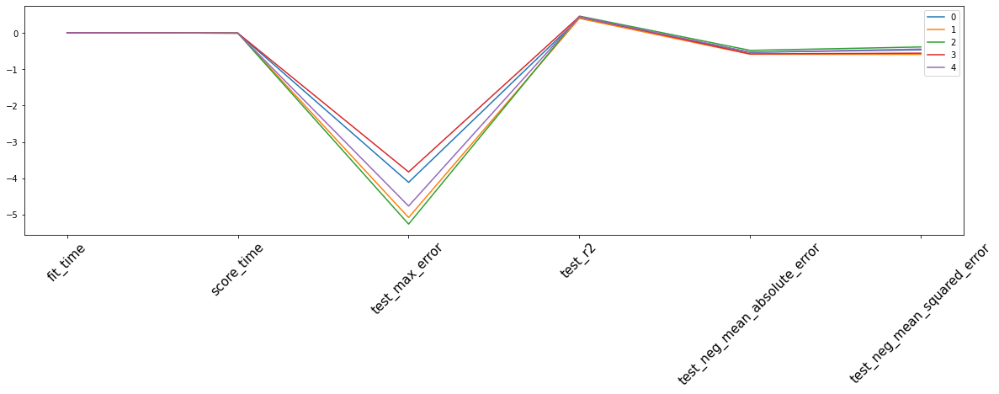

In [244]:
pd.DataFrame(cv_results).T.plot(figsize=(20,5))
plt.xticks(rotation='45', size=15)
plt.show()

In [253]:
geo_df_lis

,linkid,Daily_Average_Traffic_Intensity,Average_Velocity_of_Vehicle_Traffic,Median_of_velocity_of_Vehicle_Traffic,FirstQuartil_of_velocity_of_Vehicle_Traffic,ThirdQuartil_of_velocity_of_Vehicle_Traffic,Func_Class,Speed_Cat,geometry,Max_speed,Speed_Diff_Mean,Speed_Diff_Median,func_1,func_2,func_3,speed_2,speed_3,speed_4,speed_5,speed_6,speed_7,feat_amenity_nan,points,desc_points,point_count
0,80216819,1.058039,-0.448154,-0.476554,-0.650809,-0.335520,2,6,"MULTILINESTRING ((-9.16402 38.77030, -9.16389 ...",-0.716756,-0.549408,-0.506457,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1639781 38.7711136), POINT (-9.1642...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",8
1,80216858,-0.405185,0.964251,1.051571,1.147324,0.946946,2,4,"MULTILINESTRING ((-9.16645 38.74274, -9.16638 ...",0.624480,-0.253319,-0.414450,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,"[POINT (-9.1657458 38.7430835), POINT (-9.1658...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",21
2,80216859,-0.440889,0.404782,0.436235,0.705497,0.263588,3,6,"MULTILINESTRING ((-9.16645 38.74274, -9.16637 ...",-0.716756,-1.637509,-1.733852,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1657458 38.7430835), POINT (-9.1658...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",20
5,80216883,-0.235308,-0.977542,-0.987355,-1.020710,-0.909665,3,6,"MULTILINESTRING ((-9.17265 38.76355, -9.17286 ...",-0.716756,0.125938,0.180399,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.173357299999999 38.7635539), POINT ...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",9
6,80216931,-0.665461,-1.057537,-1.171124,-1.110384,-1.046961,3,6,"MULTILINESTRING ((-9.16657 38.74237, -9.16655 ...",-0.716756,0.227989,0.427507,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1663449 38.7428566), POINT (-9.1665...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17657,1223131558,0.386671,1.324297,1.420773,1.239799,1.424361,1,2,"MULTILINESTRING ((-9.09166 38.78631, -9.09236 ...",1.965716,1.385279,1.235920,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,[POINT (-9.0920556 38.7859912)],[feat_amenity_nan],1
17683,1223441896,-0.455862,-1.528102,-1.556125,-1.418012,-1.533737,3,6,"MULTILINESTRING ((-9.13913 38.71220, -9.13923 ...",-0.716756,0.828294,0.945205,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1391419 38.7121658), POINT (-9.1393...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",137
17684,1223441897,-0.260229,-1.620083,-1.652583,-1.472812,-1.683514,3,6,"MULTILINESTRING ((-9.13923 38.71242, -9.13927 ...",-0.716756,0.945635,1.074909,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1391419 38.7121658), POINT (-9.1393...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",130
17685,1223525691,-0.511939,-1.343291,-1.363209,-1.267312,-1.496292,3,6,"MULTILINESTRING ((-9.17550 38.70639, -9.17562 ...",-0.716756,0.592528,0.685797,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,"[POINT (-9.1755789 38.7063571), POINT (-9.1756...","[feat_amenity_nan, feat_amenity_nan, feat_amen...",5


# Heatmap Plotting Conflicted areas

In [245]:
heat_plot = geo_df_lis.copy()[['linkid', 'geometry', 'Speed_Diff_Mean', 'ThirdQuartil_of_velocity_of_Vehicle_Traffic']]


In [246]:
heat_plot = geo_df_lis.copy()[['linkid', 'geometry', 'Speed_Diff_Mean', 'ThirdQuartil_of_velocity_of_Vehicle_Traffic']]
heat_plot.Speed_Diff_Mean.describe()
# the speed diff goes from -6.13 to 4.583590
## negatives == overspeeding, positives == under the max speed

count    10602.000000
mean         0.050385
std          0.933919
min         -6.130229
25%         -0.538893
50%          0.011502
75%          0.545183
max          4.583590
Name: Speed_Diff_Mean, dtype: float64

In [247]:
# heat_plot.ThirdQuartil_of_velocity_of_Vehicle_Traffic

In [248]:
# lets only take the worse 33% of roads => avoid high memory usage
heat_plot_slice = heat_plot[heat_plot.Speed_Diff_Mean < heat_plot.Speed_Diff_Mean.quantile(.33)]
# lets invert speed diff to positive is worse than negative
heat_plot_slice['scaled_speed'] = heat_plot_slice.Speed_Diff_Mean*(-1)
# lets scale the speed diff in a range of 0,1
scale = MinMaxScaler()
heat_plot_slice['scaled_speed'] = scale.fit_transform(heat_plot_slice[['scaled_speed']])
# buffering to make the roads more visible
heat_plot_slice_buf = heat_plot_slice.copy()
heat_plot_slice_buf['geometry'] = heat_plot_slice_buf.geometry.buffer(.001)

/Users/moritzgeiger/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
/Users/moritzgeiger/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [257]:
## Filtering only lisbon data inside the circle of 38.72526068747401, -9.142352617846093 with buffer '1'
circle_lisbon = Point(-9.142352617846093, 38.72526068747401).buffer(1)
geo_lis_unscaled = gpd.GeoDataFrame(data)
geo_lis_unscaled = geo_lis_unscaled[geo_lis_unscaled.geometry.within(circle_lisbon)]

In [261]:
# geo_lis_unscaled

In [263]:
dens_plot = geo_lis_unscaled.copy()[['linkid', 'geometry', 'Daily_Average_Traffic_Intensity']]
dens_plot.Daily_Average_Traffic_Intensity.describe()
# the density goes from 31 to 27k

count    17688.000000
mean      2779.322748
std       1722.118210
min         31.317245
25%       1800.848920
50%       2349.216928
75%       3170.858817
max      26714.250016
Name: Daily_Average_Traffic_Intensity, dtype: float64

In [272]:
# lets also display the take the most dense traffic areas 33% in Lisbon as a comparison
dens_plot_slice = dens_plot[dens_plot.Daily_Average_Traffic_Intensity > dens_plot.Daily_Average_Traffic_Intensity.quantile(.33)]
# lets invert speed diff to positive is worse than negative
scale_dense = MinMaxScaler(feature_range=(0, 1))
dens_plot_slice['scaled_dens'] = scale_dense.fit_transform(dens_plot_slice[['Daily_Average_Traffic_Intensity']])
# buffering to make the roads more visible
dens_plot_slice_buf = dens_plot_slice.copy()
dens_plot_slice_buf['geometry'] = dens_plot_slice_buf.geometry.buffer(.001)


/Users/moritzgeiger/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
<ipython-input-272-97bb51bd1cfa>:8: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  dens_plot_slice_buf['geometry'] = dens_plot_slice_buf.geometry.buffer(.001)


In [282]:
dens_plot_slice_buf.scaled_dens.describe()

count    11851.000000
mean         0.057198
std          0.072624
min          0.000000
25%          0.014649
50%          0.034178
75%          0.070796
max          1.000000
Name: scaled_dens, dtype: float64

In [286]:
import branca

In [299]:
dens_plot = geo_df_lis.copy()[['linkid', 'geometry', 'Daily_Average_Traffic_Intensity']]
# lets also display the take the most dense traffic areas 33% in Lisbon as a comparison
dens_plot_slice = dens_plot[dens_plot.Daily_Average_Traffic_Intensity > dens_plot.Daily_Average_Traffic_Intensity.quantile(.33)]
# lets invert speed diff to positive is worse than negative
scale_dense = MinMaxScaler(feature_range=(0, 1))
dens_plot_slice['scaled_dens'] = scale_dense.fit_transform(dens_plot_slice[['Daily_Average_Traffic_Intensity']])
# buffering to make the roads more visible
dens_plot_slice_buf = dens_plot_slice.copy()
dens_plot_slice_buf['geometry'] = dens_plot_slice_buf.geometry.buffer(.001)


dens_plot_slice_buf


/Users/moritzgeiger/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
<ipython-input-299-da71efa8c87d>:9: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  dens_plot_slice_buf['geometry'] = dens_plot_slice_buf.geometry.buffer(.001)


,linkid,geometry,Daily_Average_Traffic_Intensity,scaled_dens
0,80216819,"POLYGON ((-9.16484 38.77098, -9.16476 38.77125...",1.058039,0.169494
1,80216858,"POLYGON ((-9.16692 38.74362, -9.16684 38.74368...",-0.405185,0.007818
2,80216859,"POLYGON ((-9.16708 38.74353, -9.16700 38.74359...",-0.440889,0.003873
5,80216883,"POLYGON ((-9.17305 38.76261, -9.17310 38.76262...",-0.235308,0.026588
8,80217095,"POLYGON ((-9.17760 38.72409, -9.17742 38.72412...",0.589618,0.117737
...,...,...,...,...
17656,1222354328,"POLYGON ((-9.23058 38.93643, -9.23066 38.93647...",-0.399515,0.008444
17657,1223131558,"POLYGON ((-9.09247 38.78540, -9.09248 38.78540...",0.386671,0.095312
17683,1223441896,"POLYGON ((-9.14014 38.71201, -9.14018 38.71210...",-0.455862,0.002218
17684,1223441897,"POLYGON ((-9.14018 38.71210, -9.14019 38.71212...",-0.260229,0.023834


In [300]:
import branca
m = Map([38.74288, -9.16624], zoom_start=12, tiles='cartodbpositron') # tile is not too intensive in the bg

## BUFFERED ROAD SEGMENTS OVER SPEEDING 
print(f'assembling over speeding map')
buf_layer = FeatureGroup(name="OVER SPEEDING", show=True)
roads_buf = Choropleth(geo_data=heat_plot_slice_buf, # geo_data
                       data=heat_plot_slice_buf, # same data to look for the color intensity
                       highlight=True, 
                       columns=['linkid', 'scaled_speed'], # chose the columns to look for [key, color_intensity]
                       key_on='properties.linkid', # chose the key
                       fill_color="OrRd", # color brewer
                       fill_opacity=0.6,
                       line_opacity=0.0, # no black lines around 
                       legend_name='Over Speeding Scaled',
                      ).geojson.add_child(GeoJsonTooltip(['linkid'])) # for mouseover information



colormap = branca.colormap.linear.OrRd_09.scale(0, 1)
colormap = colormap.to_step(index=[.0,.2,.3,.5,.6,.8,1.0])
colormap.caption = 'Over Speeding (scaled)'
colormap.add_to(m)

roads_buf
roads_buf.add_to(buf_layer)
buf_layer.add_to(m)

print(f'assembling density map')
## BUFFERED DENSITY ROAD SEGMENTS
roads_dens = Choropleth(geo_data=dens_plot_slice_buf, # geo_data
                       data=dens_plot_slice_buf, # same data to look for the color intensity
                       highlight=True, 
                       name="TRAFFIC DENSITY",
                       columns=['linkid', 'scaled_dens'], # chose the columns to look for [key, color_intensity]
                       key_on='properties.linkid', # chose the key
                       fill_color="RdPu", # color brewer
                       fill_opacity=0.6,
                       line_opacity=0.0, # no black lines around 
                       legend_name='Traffic Intensity (scaled)',
                       ).add_to(m)


LayerControl().add_to(m)
print(f'The map shows the relation between the 33% of most over speeding areas vs. the 33% of most dense traffic areas.')
print(f'Please activate and deactivate the Layers in the layer control to see the differences.')
print(f'building map...')

m

assembling over speeding map
assembling density map
The map shows the relation between the 33% of most over speeding areas vs. the 33% of most dense traffic areas.
Please activate and deactivate the Layers in the layer control to see the differences.
building map...


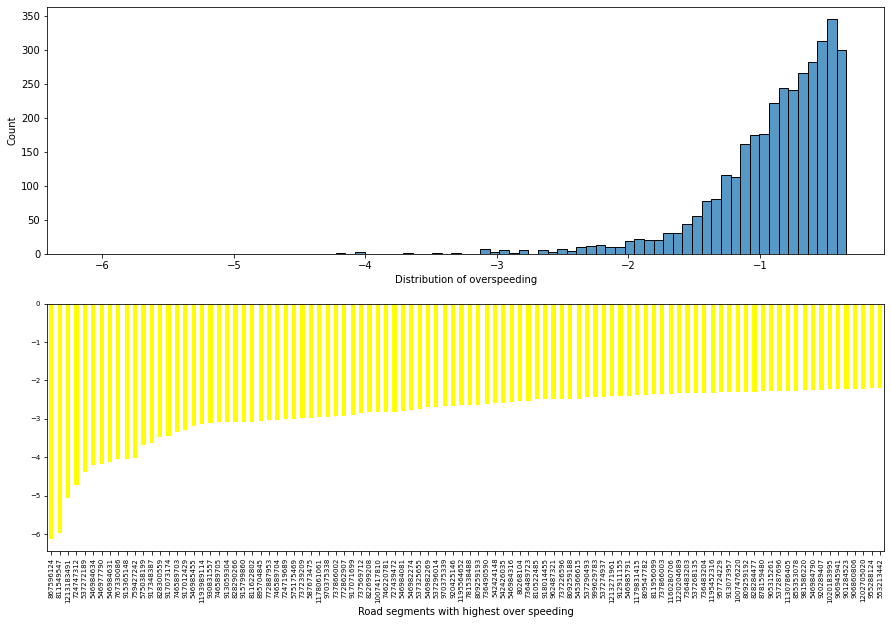

In [251]:
heat_graph_slice = pd.DataFrame(heat_plot_slice.sort_values(by='Speed_Diff_Mean').set_index('linkid'))
plt.figure(figsize=(15,10))
plt.subplot(2,1,1)
plt.xlabel('Distribution of overspeeding')
sns.histplot(heat_graph_slice.Speed_Diff_Mean, kde=False)
ax = plt.subplot(2,1,2)
heat_graph_slice.Speed_Diff_Mean.head(100).plot(kind='bar', colormap='autumn_r', fontsize=7, xlabel='Road segments with highest over speeding')
plt.show()

In [252]:
## add future steps: 
### match the data with real crash reports from lisbon to proof our hypothesis
### close the circle from our prior hypothesis
### story looks good! commenting is good and needed!
